# Поиск изображения по запросу

<div style="border:solid Chocolate 2px; padding: 40px">

## Описание проекта

    
Нам необходимо разработать демонстрационную версию поиска изображений по запросу.

Для демонстрационной версии нужно обучить модель, которая получит векторное представление изображения, векторное представление текста, а на выходе выдаст число от 0 до 1 — покажет, насколько текст и картинка подходят друг другу.

<b>Описание данны</b>

**1.** В файле `train_dataset.csv` находится информация, необходимая для обучения:
* имя файла изображения
* идентификатор описания и текст описания.

Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат `<имя файла изображения>#<порядковый номер описания>`.

**2.** В папке `train_images` содержатся изображения для тренировки модели.

В файле `CrowdAnnotations.tsv` — данные по соответствию изображения и описания, полученные с помощью краудсорсинга. Номера колонок и соответствующий тип данных:

1. Имя файла изображения.
2. Идентификатор описания.
3. Доля людей, подтвердивших, что описание соответствует изображению.
4. Количество человек, подтвердивших, что описание соответствует изображению.
5. Количество человек, подтвердивших, что описание не соответствует изображению.

**3.** В файле `ExpertAnnotations.tsv` содержатся данные по соответствию изображения и описания, полученные в результате опроса экспертов. Номера колонок и соответствующий тип данных:

    1. Имя файла изображения.
    2. Идентификатор описания.

    3, 4, 5 — оценки трёх экспертов.

    Эксперты ставят оценки по шкале от 1 до 4, где 1 — изображение и запрос совершенно не соответствуют друг другу, 2 —  запрос содержит элементы описания изображения, но в целом запрос тексту не соответствует, 3 — запрос и текст    соответствуют с точностью до некоторых деталей, 4 — запрос и текст соответствуют полностью.

**4.** В файле `test_queries.csv` находится информация, необходимая для тестирования: идентификатор запроса, текст запроса и релевантное изображение. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат `<имя файла изображения>#<порядковый номер описания>`.

**5.** В папке `test_images` содержатся изображения для тестирования модели.

## 1. Исследовательский анализ данных

Наш датасет содержит экспертные и краудсорсинговые оценки соответствия текста и изображения.

В файле с экспертными мнениями для каждой пары изображение-текст имеются оценки от трёх специалистов. Для решения задачи вы должны эти оценки агрегировать — превратить в одну. Существует несколько способов агрегации оценок, самый простой — голосование большинства: за какую оценку проголосовала большая часть экспертов (в нашем случае 2 или 3), та оценка и ставится как итоговая. Поскольку число экспертов меньше числа классов, может случиться, что каждый эксперт поставит разные оценки, например: 1, 4, 2. В таком случае данную пару изображение-текст можно исключить из датасета.

Вы можете воспользоваться другим методом агрегации оценок или придумать свой.

В файле с краудсорсинговыми оценками информация расположена в таком порядке:

1. Доля исполнителей, подтвердивших, что текст **соответствует** картинке.
2. Количество исполнителей, подтвердивших, что текст **соответствует** картинке.
3. Количество исполнителей, подтвердивших, что текст **не соответствует** картинке.

После анализа экспертных и краудсорсинговых оценок выберите либо одну из них, либо объедините их в одну по какому-то критерию: например, оценка эксперта принимается с коэффициентом 0.6, а крауда — с коэффициентом 0.4.

Ваша модель должна возвращать на выходе вероятность соответствия изображения тексту, поэтому целевая переменная должна иметь значения от 0 до 1.


In [68]:
def load_image(path):
    image_test = Image.open(path)
    return image_test

    
image_test = load_image('./cover_orig.jpg')

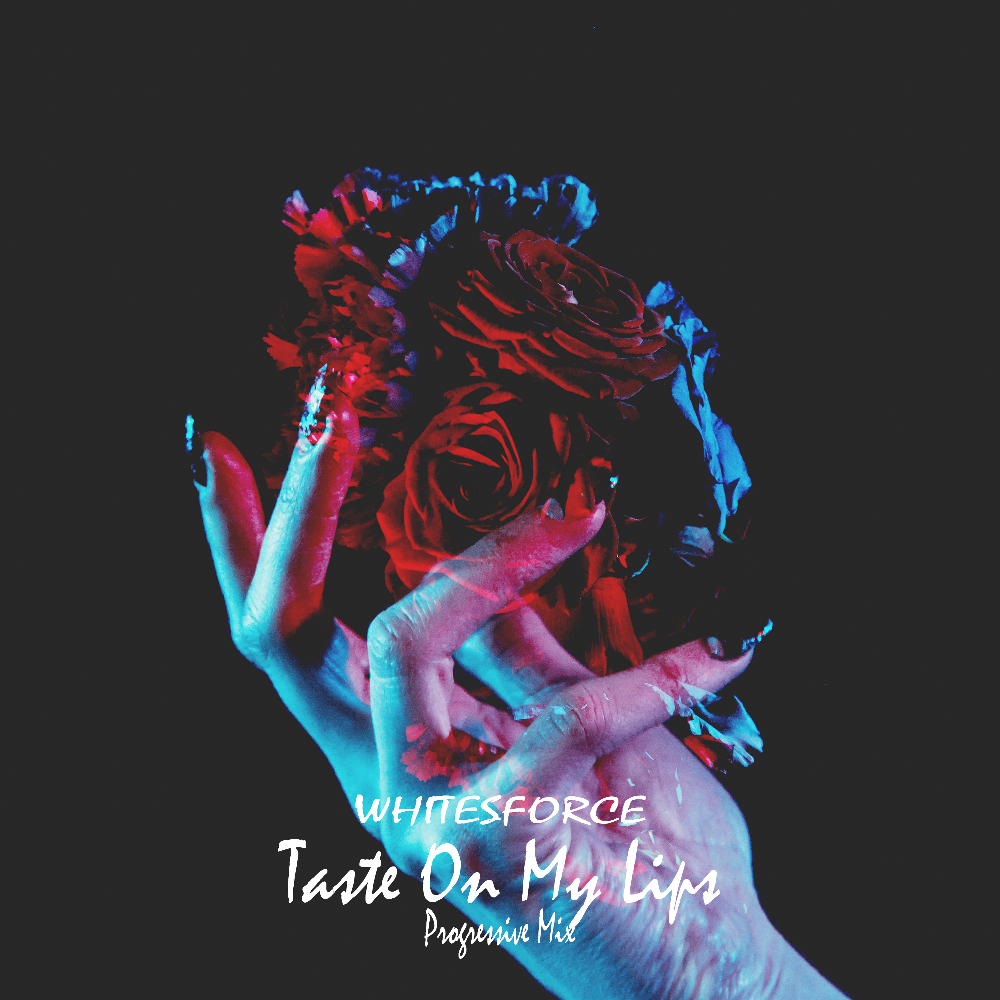

In [69]:
image_test

In [84]:
features_train.values

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.2275046 , 0.        , 1.0090117 , ..., 0.06359123, 0.        ,
        0.        ],
       [0.00496347, 0.01516101, 0.01806104, ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.43797946, 0.01121893, 0.01352807, ..., 0.        , 0.        ,
        0.00455463],
       [0.35928953, 0.        , 0.25897136, ..., 0.        , 0.        ,
        0.01269492],
       [0.        , 0.00233757, 0.01098999, ..., 0.03086408, 0.        ,
        0.11173484]])

In [91]:
image_test = load_image('./cover_orig.jpg')

resnet = models.resnet50( weights="IMAGENET1K_V2")
for param in resnet.parameters():
### замораживаем веса
    param.requires_grad_(False)
modules = list(resnet.children())[:-1]
resnet = nn.Sequential(*modules)
resnet.eval()
norm = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                        std=[0.229, 0.224, 0.225]
                        )
preprocess = transforms.Compose([transforms.Resize(224),
                                 transforms.ToTensor(),
                             norm])
    

In [103]:
image_vec = []
img = image_test.convert('RGB')
image_tensor = preprocess(img)
output_tensor = resnet(image_tensor.unsqueeze(0)).flatten().numpy()
image_vec.append(output_tensor)
# df_img_test = pd.DataFrame(image_vec)
# df_img_test
len(output_tensor)

2048

In [106]:
neigh.predict(image_vec)

array(['edm'], dtype=object)

In [70]:

def vectorize_img_test(image_test):

    resnet = models.resnet50( weights="IMAGENET1K_V2")
    for param in resnet.parameters():
    ### замораживаем веса
        param.requires_grad_(False)
    
### берём все слои кроме последнего
    modules = list(resnet.children())[:-1]
    resnet = nn.Sequential(*modules)
    resnet.eval()

    norm = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                            std=[0.229, 0.224, 0.225]
                            )
    preprocess = transforms.Compose([transforms.Resize(224),
                                     transforms.ToTensor(),
                                 norm])
    
    


    image_vec = []
    img = image_test.convert('RGB')
    image_tensor = preprocess(img)
    output_tensor = resnet(image_tensor.unsqueeze(0)).flatten().numpy()
    image_vec.append(output_tensor)
    df_img_test = pd.DataFrame(image_vec)
    df_img_test    
    return df_img_test


df_img_test = vectorize_img_test(image_test)
df_img_test

,0,1,2,3,4,5,6,7,8,9,...,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047
0,0.009297,0.094071,0.0,0.0,1.011872,0.003793,0.793121,0.06855,0.499051,0.0,...,0.086651,0.0,0.0,0.324311,0.0,0.234853,0.279213,0.009489,0.0,0.417273


In [70]:
def vectorize_img_test(image_test):

    resnet = models.resnet50( weights="IMAGENET1K_V2")
    for param in resnet.parameters():
    ### замораживаем веса
        param.requires_grad_(False)
    
### берём все слои кроме последнего
    modules = list(resnet.children())[:-1]
    resnet = nn.Sequential(*modules)
    resnet.eval()

    norm = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                            std=[0.229, 0.224, 0.225]
                            )
    preprocess = transforms.Compose([transforms.Resize(224),
                                     transforms.ToTensor(),
                                 norm])
    
    


    image_vec = []
    img = image_test.convert('RGB')
    image_tensor = preprocess(img)
    output_tensor = resnet(image_tensor.unsqueeze(0)).flatten().numpy()
    image_vec.append(output_tensor)
    df_img_test = pd.DataFrame(image_vec)
    df_img_test    
    return df_img_test


df_img_test = vectorize_img_test(image_test)
df_img_test

,0,1,2,3,4,5,6,7,8,9,...,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047
0,0.009297,0.094071,0.0,0.0,1.011872,0.003793,0.793121,0.06855,0.499051,0.0,...,0.086651,0.0,0.0,0.324311,0.0,0.234853,0.279213,0.009489,0.0,0.417273


In [71]:
preds = neigh_2.predict(df_img_test)
preds

array(['edm'], dtype=object)

In [ ]:
# !pip install umap-learn
# pip install umap-learn[plot]

In [2]:
import pandas as pd
import numpy as np
# import re
import time
import statistics as stat
# import math
import random


from tqdm import tqdm
from tqdm import notebook

import torch
import torch.nn as nn
import torchvision.models as models
# from torchvision.models import resnet18
from torchvision import transforms

# import transformers
# from transformers import BertTokenizer, BertModel

import warnings
warnings.filterwarnings("ignore")

from PIL import Image

import sklearn
# from sklearn.linear_model import LinearRegression, ElasticNet
# from sklearn.preprocessing import MinMaxScaler
# from sklearn.model_selection import GroupShuffleSplit, GridSearchCV
# from sklearn.metrics import f1_score
from sklearn.metrics import classification_report, f1_score

from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
# from sklearn.utils import shuffle
from sklearn.preprocessing import StandardScaler, OneHotEncoder, OrdinalEncoder
from sklearn.metrics import f1_score, precision_score, recall_score, roc_curve, roc_auc_score, \
                            make_scorer, classification_report, accuracy_score
# from sklearn.linear_model import LogisticRegression
# from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import make_column_transformer
# from sklearn.dummy import DummyClassifier

import lightgbm as lgb
from lightgbm import LGBMRegressor

import sentence_transformers
from sentence_transformers import SentenceTransformer, util

import os

from sklearn.model_selection import train_test_split


import random

RANDOM_STATE = 12345

# from sklearn.dummy import DummyClassifier
import faiss
import umap 
import umap.plot  

# from catboost import CatBoostClassifier, Pool

# import lightgbm as lgb
# from lightgbm import LGBMClassifier

C:\Users\Katya\AppData\Roaming\Python\Python311\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
C:\ProgramData\anaconda3\Lib\site-packages\transformers\utils\generic.py:441: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  _torch_pytree._register_pytree_node(


In [100]:
# ! pip install fastai

In [6]:
from fastai.vision.all import *

Импортируем данные и напишем функцию для просмотра информации о датафреймах.

## Загрузим данные

In [7]:
# Определим список музыкальных жанров
genres = ['anime',
          'black metal',
          'classical',
          'country',
          'disco',
          'edm',
          'jazz',
          'pop',
          'rap',
          'reggae']

path = "./"

In [8]:
def get_img_names(genre, path):
    
    # Указываем путь к директории
    directory = path + genre + '/' + genre + '/'

    # Получаем список файлов
    files = os.listdir(directory)
    
    df = pd.DataFrame(files, columns=['image'])
    df['genre'] = genre
    # Добавление пути к названию изображения
    df['image'] = df['image'].apply(lambda x: directory + x)
    return df

In [9]:
def create_data_frame(genres):
    
    data = pd.DataFrame(columns=['image', 'genre'])

    for genre in genres:
        df = get_img_names(genre, path)
#         print(df.shape[0])
        data = pd.concat([data, df], ignore_index= True )
#         print(data.shape[0])
        
    return data

In [10]:
data = create_data_frame(genres)
print(data.shape)
data.head()

(7800, 2)


,image,genre
0,./anime/anime/00095702-6b86-4bb1-880e-1e09e759a013.png,anime
1,./anime/anime/0091bee3-a67a-457e-8c5f-b4a1055b1211.png,anime
2,./anime/anime/00a9d688-337f-4807-83cd-596540f1683b.png,anime
3,./anime/anime/00ddb3de-75db-4e27-ad3d-441a5dc95636.png,anime
4,./anime/anime/00ec64ef-c6ab-4a63-91df-59ce8db4ea25.png,anime


проверим данные на дубликаты

проверим данные на дубликаты

In [11]:
# проверим данные на дубликаты
data.duplicated().sum()

0

In [12]:
# Проверим баланс классов
data['genre'].value_counts(normalize=True)

genre
country        0.190513
anime          0.152436
classical      0.122436
jazz           0.105256
pop            0.102949
edm            0.092179
reggae         0.074487
disco          0.060000
black metal    0.057692
rap            0.042051
Name: proportion, dtype: float64

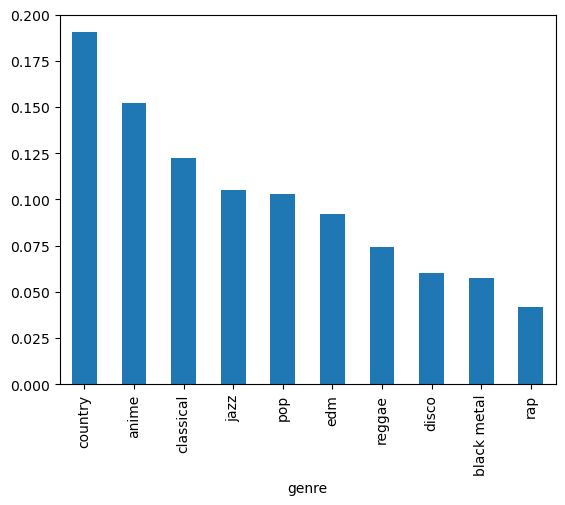

In [13]:
# Проверим баланс классов
data['genre'].value_counts(normalize=True).plot(kind='bar');

Жанр: reggae
(300, 300)


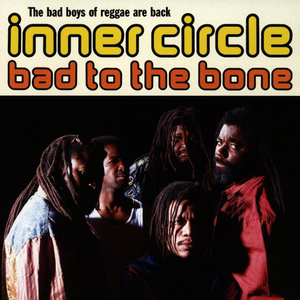

Жанр: black metal
(300, 300)


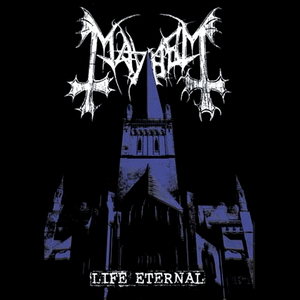

Жанр: classical
(300, 300)


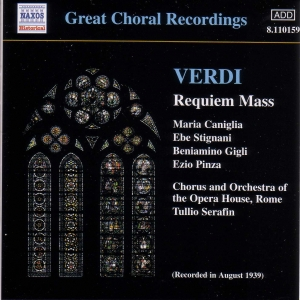

Жанр: rap
(300, 300)


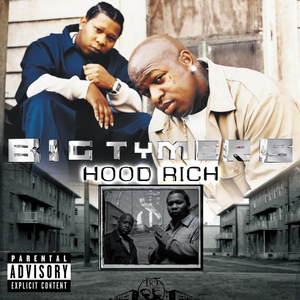

Жанр: pop
(300, 300)


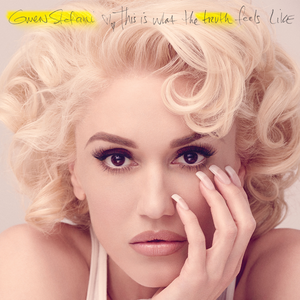

In [11]:
# Выведем несолько изображений
for i in [random.randint(0, data.shape[0]-1) for i in range(5)]:
    image_name = data.iloc[i]['image']
    img_genre = data.iloc[i]['genre']
#     img = Image.open(path + img_genre + '/' + img_genre + '/' + image_name).convert('RGB')
    img = Image.open(image_name).convert('RGB')
    print(f'Жанр: {img_genre}')
    print(img.size)
    display(img)

## 3. Векторизация изображений



Для векторизации изображений используем предобученную resnet18. Уберем последний слой, чтобы получить на выходе вектор. На примере одного из изображений посмотрим, какой вектор получается.

In [14]:
%%time
resnet = models.resnet50( weights="IMAGENET1K_V2")

for param in resnet.parameters():
    ### замораживаем веса
    param.requires_grad_(False)
    
### берём все слои кроме последнего
modules = list(resnet.children())[:-1]
resnet = nn.Sequential(*modules)
resnet.eval();

### переводим изображение в нужный формат: меняем размер картинки, вырезаем центр и нормализуем
norm = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                            std=[0.229, 0.224, 0.225]
                            )
preprocess = transforms.Compose([transforms.Resize(224),
                                 transforms.ToTensor(),
                                 norm])


### Напишем функцию для векторизации изображений
def vectorize_img(data, path):
    image_vec = []
    img_names = pd.DataFrame(data.image, columns=['image'])
    for image, genre in tqdm(zip(data['image'], data['genre'])):
#         img = Image.open(path + genre + '/' + genre + '/' + image).convert('RGB')
        img = Image.open(image).convert('RGB')
        image_tensor = preprocess(img)
        output_tensor = resnet(image_tensor.unsqueeze(0)).flatten().numpy()
        image_vec.append(output_tensor)
    print(f'Размер вектора изображений: {np.array(image_vec).shape}')

    df_img = pd.concat([img_names, pd.DataFrame(image_vec)], axis= 1)
#     df_img.columns = ['img_' + str(column) if isinstance(column, int) 
#                              else str(column) for column in df_img.columns]    
    return df_img


df_img = vectorize_img(data, path)

177it [00:10, 17.26it/s]


KeyboardInterrupt: 

In [11]:
resnet = models.resnet18(pretrained=True)
for param in resnet.parameters():
    ### замораживаем веса
    param.requires_grad_(False)
    
### берём все слои кроме последнего
modules = list(resnet.children())[:-1]
resnet = nn.Sequential(*modules)
resnet.eval();

### переводим изображение в нужный формат: меняем размер картинки, вырезаем центр и нормализуем
norm = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                            std=[0.229, 0.224, 0.225]
                            )
preprocess = transforms.Compose([transforms.Resize(256),
                                 transforms.CenterCrop(224),
                                 transforms.ToTensor(),
                                 norm])

Жанр: anime
(300, 300)


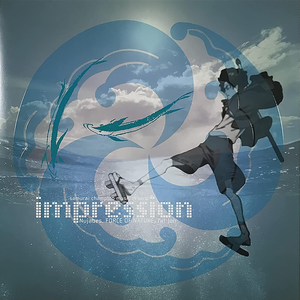

In [61]:
# Для проверки работы применим векторизацию к одному изображению
row = data.sample(1)

row = data.sample(1)
image_name = row.iloc[0]['image']
img_genre = row.iloc[0]['genre']
img = Image.open(path + img_genre + '/' + img_genre + '/' + image_name).convert('RGB')
print(f'Жанр: {img_genre}')
print(img.size)
display(img)

image_tensor = preprocess(img)
output_tensor = resnet(image_tensor.unsqueeze(0)).flatten()
output_tensor.size()

torch.Size([2048])

Поличили вектор размерностью 512.

Напишем функцию для векторизации изображений

In [21]:
### Напишем функцию для векторизации изображений
def vectorize_img(data, path):
    image_vec = []
    img_names = pd.DataFrame(data.image, columns=['image'])
    for image, genre in tqdm(zip(data['image'], data['genre'])):
        img = Image.open(path + genre + '/' + genre + '/' + image).convert('RGB')
        image_tensor = preprocess(img)
        output_tensor = resnet(image_tensor.unsqueeze(0)).flatten().numpy()
        image_vec.append(output_tensor)
    print(f'Размер вектора изображений: {np.array(image_vec).shape}')

    df_img = pd.concat([img_names, pd.DataFrame(image_vec)], axis= 1)
#     df_img.columns = ['img_' + str(column) if isinstance(column, int) 
#                              else str(column) for column in df_img.columns]    
    return df_img

In [22]:
%%time
df_img = vectorize_img(data, path)

2594it [01:35, 27.20it/s]


Размер вектора изображений: (2594, 512)
CPU times: total: 12min 43s
Wall time: 1min 35s


In [21]:
df_img['target'] = data['genre']

In [22]:
df_img.set_index('image', inplace=True)

In [94]:
df_img.head()

,0,1,2,3,4,5,6,7,8,9,...,2039,2040,2041,2042,2043,2044,2045,2046,2047,target
image,,,,,,,,,,,,,,,,,,,,,
./anime/anime/00095702-6b86-4bb1-880e-1e09e759a013.png,0.206014,0.013719,0.049659,0.025440,0.239821,0.105520,0.013550,0.202331,0.067909,0.008109,...,0.005250,0.000000,0.173698,0.030903,0.000000,0.011865,0.014338,0.0,0.000000,anime
./anime/anime/0091bee3-a67a-457e-8c5f-b4a1055b1211.png,0.003967,0.000000,0.001536,0.050578,0.669092,0.000000,0.076952,0.795427,0.000000,0.058550,...,0.003525,0.169340,0.000000,0.000000,0.283309,0.063567,0.003434,0.0,0.019173,anime
./anime/anime/00a9d688-337f-4807-83cd-596540f1683b.png,0.051324,0.000000,0.093014,0.443881,0.986939,0.044447,0.273377,0.548700,0.164716,0.000000,...,0.000000,0.000000,0.014138,0.000000,0.013032,0.000000,0.000000,0.0,0.110995,anime
./anime/anime/00ddb3de-75db-4e27-ad3d-441a5dc95636.png,0.039618,0.179682,0.096209,0.000000,0.376749,0.032519,0.057986,0.009625,0.227785,0.000380,...,0.022648,0.120641,0.007919,0.028745,0.084568,0.074516,0.016802,0.0,0.016342,anime
./anime/anime/00ec64ef-c6ab-4a63-91df-59ce8db4ea25.png,0.082114,0.002415,0.121753,0.000811,0.397554,0.000000,0.183582,0.173981,0.443419,0.000405,...,0.637867,0.055761,0.000000,0.000000,0.035134,0.057372,0.000000,0.0,0.000000,anime


**Вывод**
Используя предобученную resnet18 мы получили вектора для каждого уникального изображения из обучающего датасета.

In [324]:
enc = OrdinalEncoder()
target_enc = enc.fit_transform(df_img['target'].to_frame())

In [326]:
X = df_img[df_img.columns.drop('target')]
y = target_enc

In [342]:
manifold = umap.UMAP(n_components=20, n_neighbors=15).fit(X, y)
X_reduced = manifold.transform(X)
X_reduced.shape

(7760, 20)

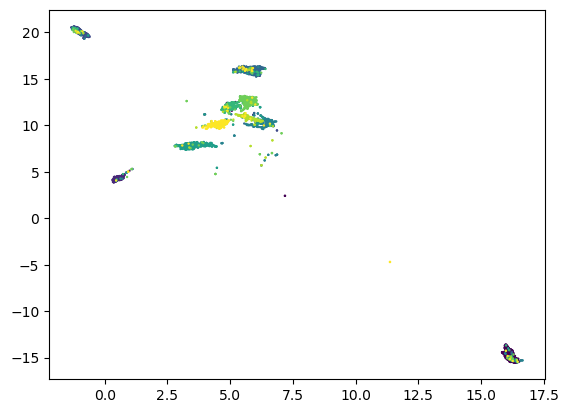

In [343]:
plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=y, s=0.5);

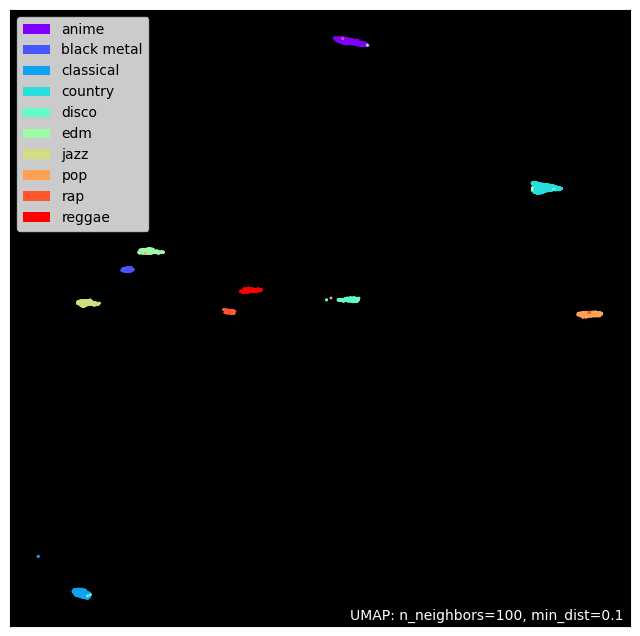

In [337]:


umap.plot.points(manifold, labels=df_img['target'].to_numpy(), theme="fire");

In [292]:
y = np.asarray([elem[0] for elem in target_enc])
y

array([0., 0., 0., ..., 2., 2., 2.])

In [296]:
df_img['target'].unique()

array(['anime', 'black metal', 'classical'], dtype=object)

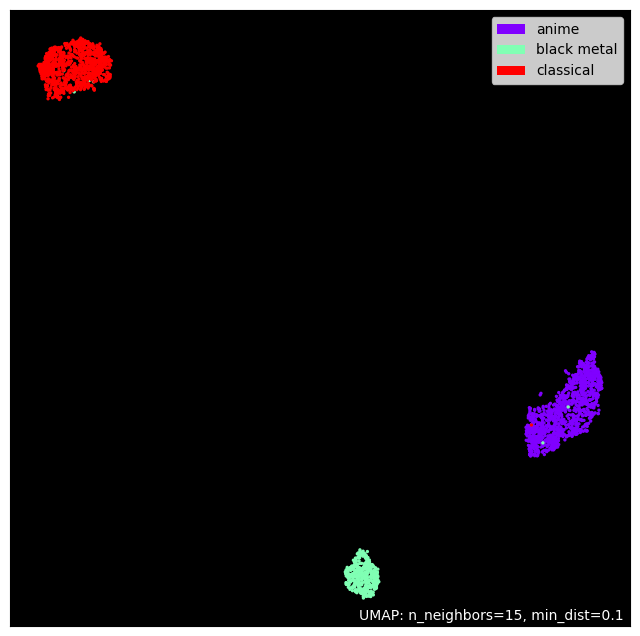

In [298]:
import umap.plot  # pip install umap-learn[plot]

umap.plot.points(manifold, labels=df_img['target'].to_numpy(), theme="fire");

## Поиск и удаление дубликатов

In [18]:
df_img.duplicated().sum()

NameError: name 'df_img' is not defined

In [115]:
data_duplicated = df_img[df_img.duplicated(keep=False)==True].copy()
data_duplicated

,0,1,2,3,4,5,6,7,8,9,...,2039,2040,2041,2042,2043,2044,2045,2046,2047,target
image,,,,,,,,,,,,,,,,,,,,,
./anime/anime/02eb263f-18b1-4b06-b1ec-1bd4112bdda6.png,0.032453,0.020744,0.113849,0.016689,0.502387,0.000000,0.021129,0.019619,0.384587,0.000000,...,0.123093,0.005941,0.035785,0.000416,0.010230,0.004299,0.010970,0.020068,0.362895,anime
./anime/anime/054883a9-b2e2-4e52-ad52-c980ea768cf0.png,0.032453,0.020744,0.113849,0.016689,0.502387,0.000000,0.021129,0.019619,0.384587,0.000000,...,0.123093,0.005941,0.035785,0.000416,0.010230,0.004299,0.010970,0.020068,0.362895,anime
./anime/anime/0b4c78ca-b3b2-45d4-84ac-f401cfe441d9.png,0.320836,0.039214,0.354834,0.018698,0.775409,0.080704,0.000000,0.295851,0.441379,0.000000,...,0.017400,0.228402,0.090356,0.000000,0.000000,0.094463,0.016028,0.000000,0.885365,anime
./anime/anime/10d9da17-1902-43d2-898e-ebc7563608bb.png,0.103859,0.019966,0.073377,0.000000,0.008871,0.000000,0.000000,0.144043,0.000000,0.000000,...,0.018700,0.082420,0.004347,0.010778,0.069808,0.026255,0.042368,0.000000,0.000000,anime
./anime/anime/16072b25-550c-43b3-9cd3-6f575ec0a0ee.png,0.103859,0.019966,0.073377,0.000000,0.008871,0.000000,0.000000,0.144043,0.000000,0.000000,...,0.018700,0.082420,0.004347,0.010778,0.069808,0.026255,0.042368,0.000000,0.000000,anime
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
./pop/pop/82e9a9af-7a8b-4836-b0e1-a0b3185e0975.png,0.296798,0.000000,0.006632,0.000000,1.639579,0.000000,0.000000,1.888244,0.000000,0.000000,...,0.162641,0.121032,0.000000,0.000000,0.056335,1.373585,0.000000,0.019867,0.000000,pop
./pop/pop/ed9baabb-11bb-487f-9bc4-2096e693fa3e.png,0.397165,0.040274,0.460390,0.001725,1.048398,0.000000,0.010505,1.690080,0.005603,0.000000,...,0.016050,0.000000,0.000826,0.000000,0.451971,0.009999,0.000630,0.000000,0.000000,pop
./reggae/reggae/115b13b6-39de-4b92-b3d6-0221861ed572.png,0.054460,0.014039,0.022703,0.000235,0.438290,0.006029,0.148662,0.150685,0.000000,0.001816,...,0.000000,0.055041,0.012013,0.000000,0.000000,0.333153,0.000000,0.000000,0.098911,reggae


In [69]:
# data_duplicated.reset_index(inplace= True )
# data_duplicated

In [116]:
col_list = list(data_duplicated.columns)

In [117]:
data_duplicated.sort_values(by=col_list, inplace=True)

In [118]:
data_duplicated

,0,1,2,3,4,5,6,7,8,9,...,2039,2040,2041,2042,2043,2044,2045,2046,2047,target
image,,,,,,,,,,,,,,,,,,,,,
./anime/anime/48f2154c-2867-4253-9076-bc5d0aa800db.png,0.000000,0.000000,0.000000,0.000000,0.067096,0.000000,0.104285,0.000000,0.000000,0.000000,...,0.000000,0.398314,0.000000,0.000000,0.016263,0.124077,0.000000,0.000000,0.000000,anime
./anime/anime/bf9fe9d3-9393-4d02-9e21-db866297241b.png,0.000000,0.000000,0.000000,0.000000,0.067096,0.000000,0.104285,0.000000,0.000000,0.000000,...,0.000000,0.398314,0.000000,0.000000,0.016263,0.124077,0.000000,0.000000,0.000000,anime
./edm/edm/6c06dc0f-99e7-477c-868e-eefd0959723d.png,0.000000,0.000000,0.067758,0.000000,0.466903,0.000000,0.048593,0.001751,0.022790,0.001106,...,0.052034,0.197126,0.000745,0.000000,0.090075,0.001288,0.014196,0.000000,0.023263,edm
./edm/edm/9bc8f53e-f3a2-4786-b774-45219b8fa838.png,0.000000,0.000000,0.067758,0.000000,0.466903,0.000000,0.048593,0.001751,0.022790,0.001106,...,0.052034,0.197126,0.000745,0.000000,0.090075,0.001288,0.014196,0.000000,0.023263,edm
./disco/disco/5fedda2c-3c6b-42b6-94e3-0579dfd31fa8.png,0.000000,0.004742,0.031062,0.000000,0.196882,0.000000,0.005439,0.086974,0.019333,0.000000,...,0.000000,0.009033,0.000000,0.095448,0.033401,0.016471,0.005177,0.000000,0.003887,disco
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
./pop/pop/82e9a9af-7a8b-4836-b0e1-a0b3185e0975.png,0.296798,0.000000,0.006632,0.000000,1.639579,0.000000,0.000000,1.888244,0.000000,0.000000,...,0.162641,0.121032,0.000000,0.000000,0.056335,1.373585,0.000000,0.019867,0.000000,pop
./anime/anime/0b4c78ca-b3b2-45d4-84ac-f401cfe441d9.png,0.320836,0.039214,0.354834,0.018698,0.775409,0.080704,0.000000,0.295851,0.441379,0.000000,...,0.017400,0.228402,0.090356,0.000000,0.000000,0.094463,0.016028,0.000000,0.885365,anime
./anime/anime/e0f6f77d-b589-4370-aa16-975fa91f481e.png,0.320836,0.039214,0.354834,0.018698,0.775409,0.080704,0.000000,0.295851,0.441379,0.000000,...,0.017400,0.228402,0.090356,0.000000,0.000000,0.094463,0.016028,0.000000,0.885365,anime


Жанр: anime
(300, 300)


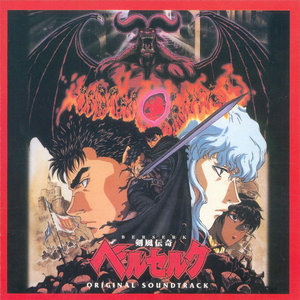

Жанр: anime
(300, 300)


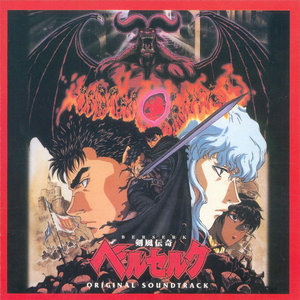

Жанр: edm
(300, 300)


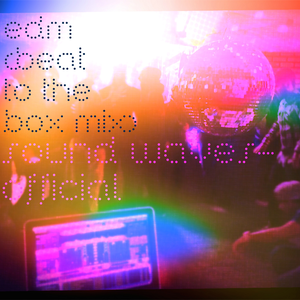

Жанр: edm
(300, 300)


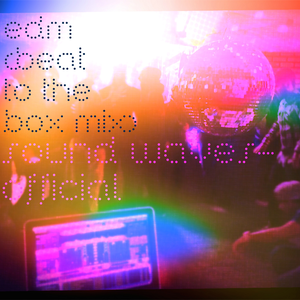

Жанр: disco
(300, 300)


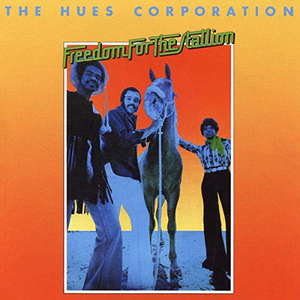

Жанр: disco
(300, 300)


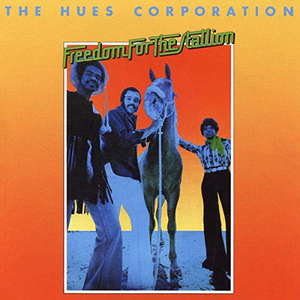

Жанр: country
(300, 300)


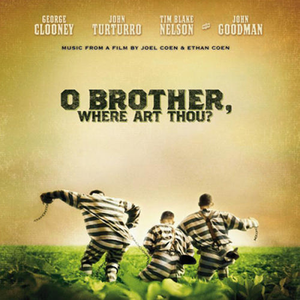

Жанр: country
(300, 300)


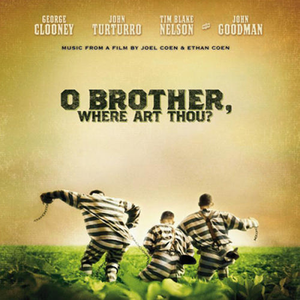

Жанр: country
(300, 300)


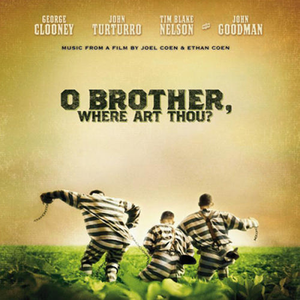

Жанр: pop
(300, 300)


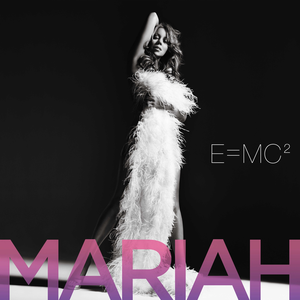

Жанр: pop
(300, 300)


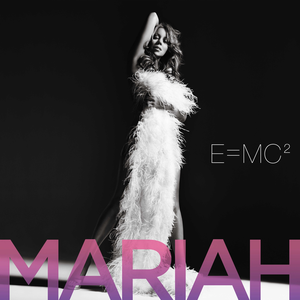

Жанр: jazz
(300, 300)


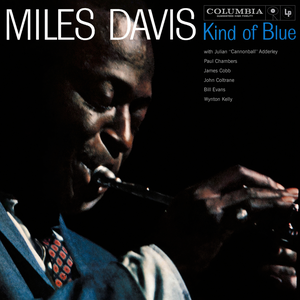

Жанр: jazz
(300, 300)


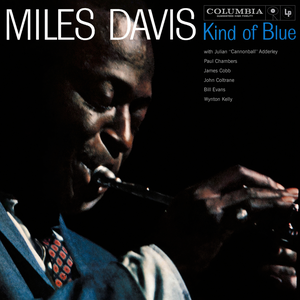

Жанр: edm
(300, 300)


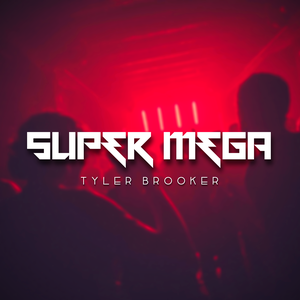

Жанр: edm
(300, 300)


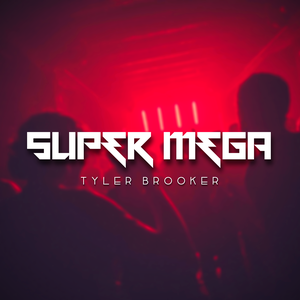

Жанр: classical
(300, 300)


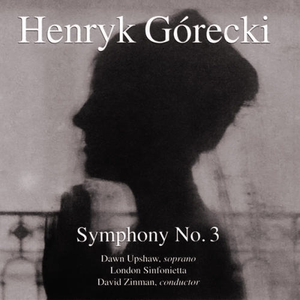

Жанр: classical
(300, 300)


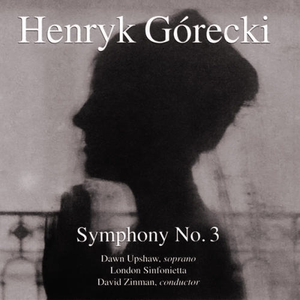

Жанр: classical
(300, 300)


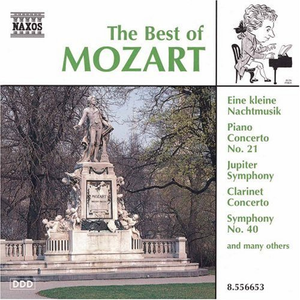

Жанр: classical
(300, 300)


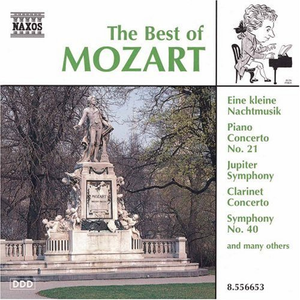

Жанр: edm
(300, 300)


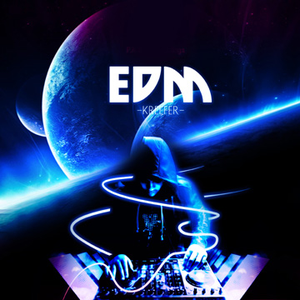

Жанр: edm
(300, 300)


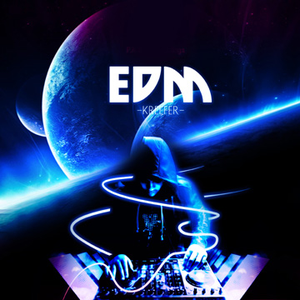

Жанр: black metal
(300, 300)


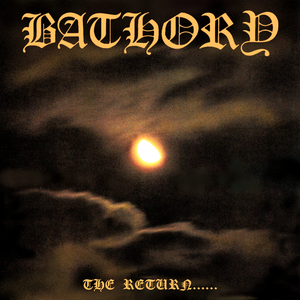

Жанр: black metal
(300, 300)


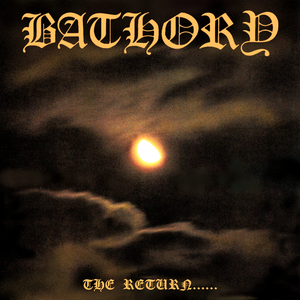

Жанр: edm
(300, 300)


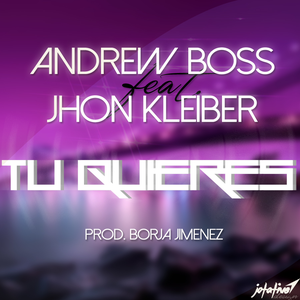

Жанр: edm
(300, 300)


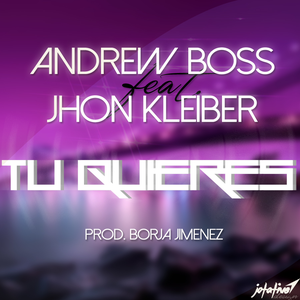

Жанр: country
(300, 300)


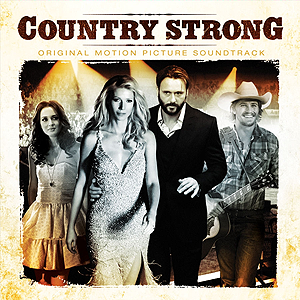

Жанр: country
(300, 300)


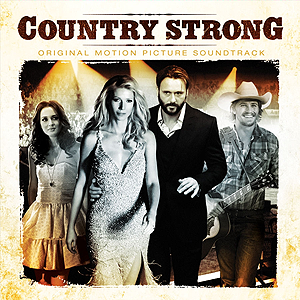

Жанр: edm
(300, 300)


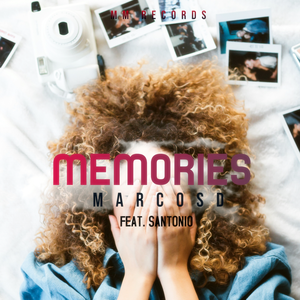

Жанр: edm
(300, 300)


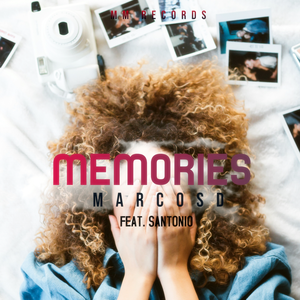

Жанр: edm
(300, 300)


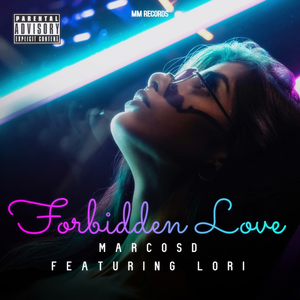

Жанр: edm
(300, 300)


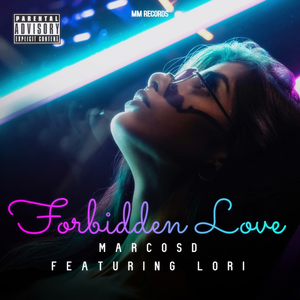

Жанр: edm
(300, 300)


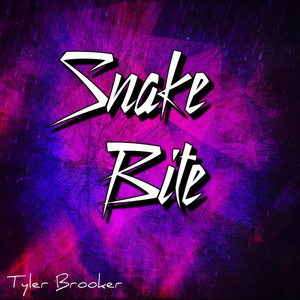

Жанр: edm
(300, 300)


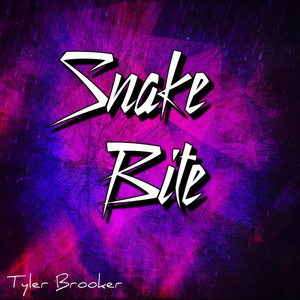

Жанр: edm
(300, 300)


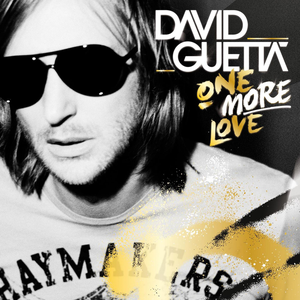

Жанр: edm
(300, 300)


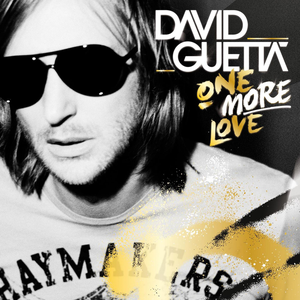

Жанр: anime
(300, 300)


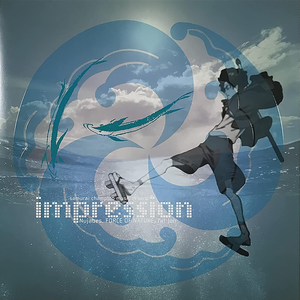

Жанр: anime
(300, 300)


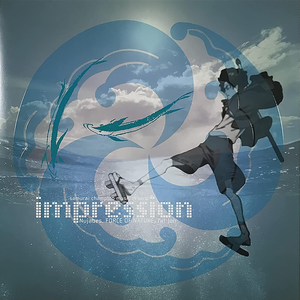

Жанр: edm
(300, 300)


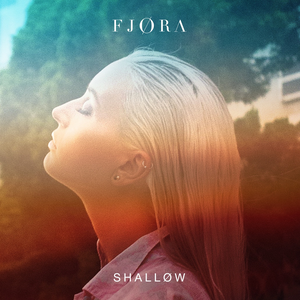

Жанр: edm
(300, 300)


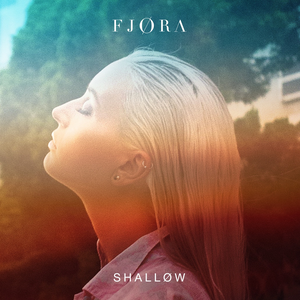

Жанр: edm
(300, 300)


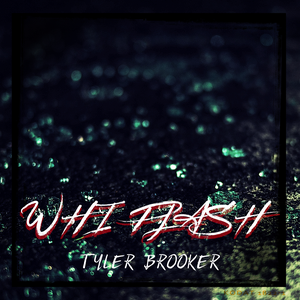

Жанр: edm
(300, 300)


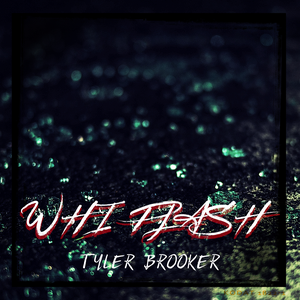

Жанр: reggae
(300, 300)


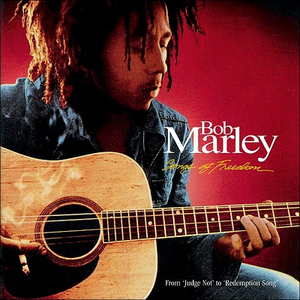

Жанр: reggae
(300, 300)


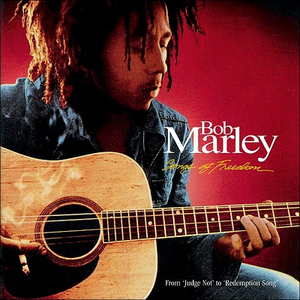

Жанр: reggae
(300, 300)


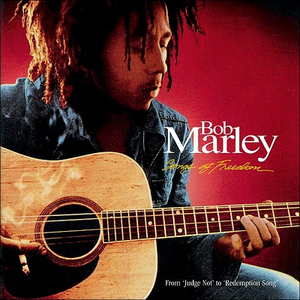

Жанр: edm
(300, 300)


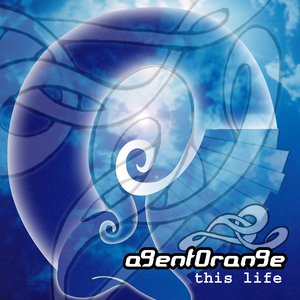

Жанр: edm
(300, 300)


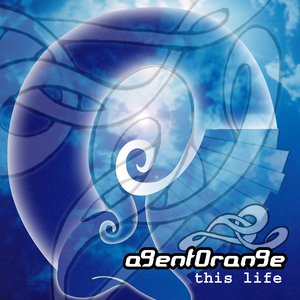

Жанр: edm
(300, 300)


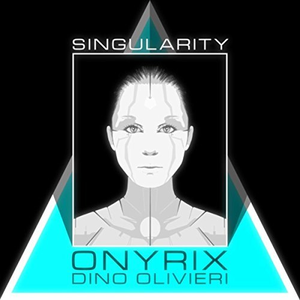

Жанр: edm
(300, 300)


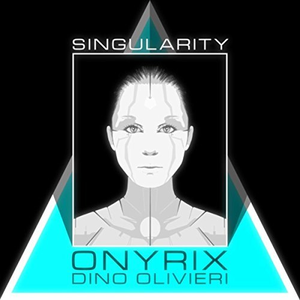

Жанр: jazz
(300, 300)


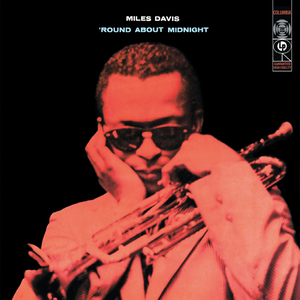

Жанр: jazz
(300, 300)


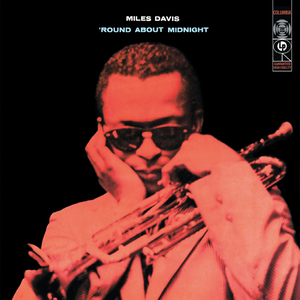

Жанр: disco
(300, 300)


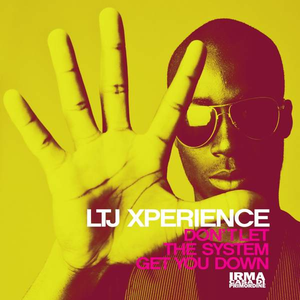

Жанр: disco
(300, 300)


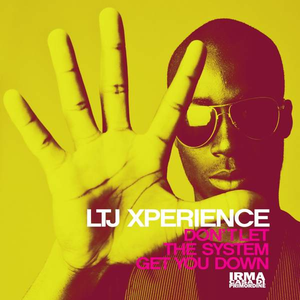

Жанр: edm
(300, 300)


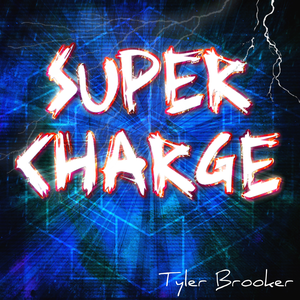

Жанр: edm
(300, 300)


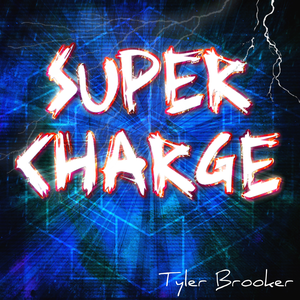

Жанр: edm
(300, 300)


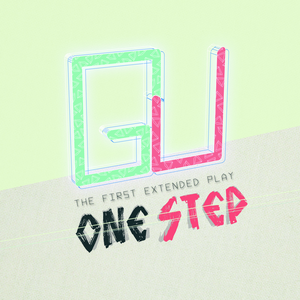

Жанр: edm
(300, 300)


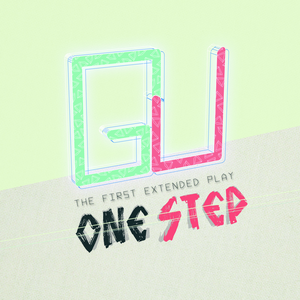

Жанр: edm
(300, 300)


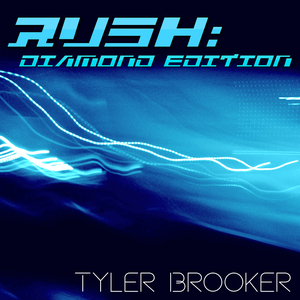

Жанр: edm
(300, 300)


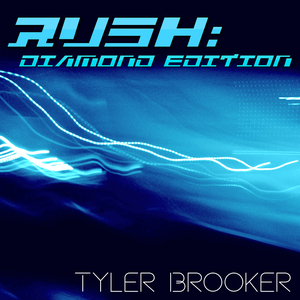

Жанр: anime
(300, 300)


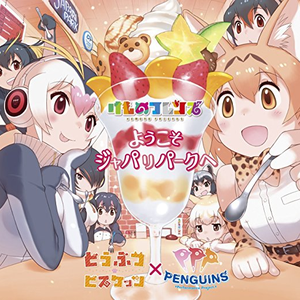

Жанр: anime
(300, 300)


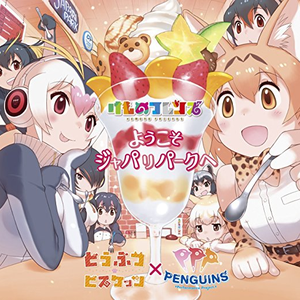

Жанр: edm
(300, 300)


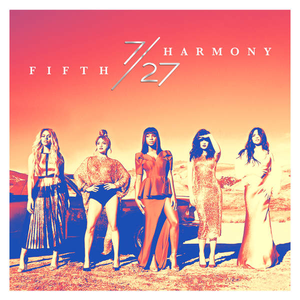

Жанр: edm
(300, 300)


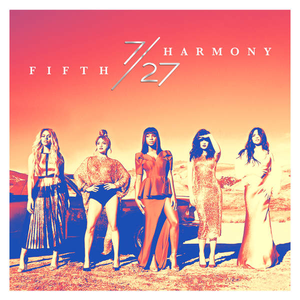

Жанр: anime
(300, 300)


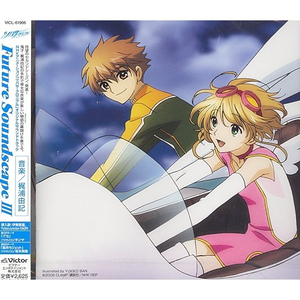

Жанр: anime
(300, 300)


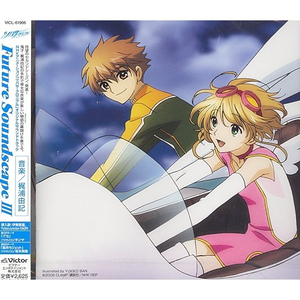

Жанр: pop
(300, 300)


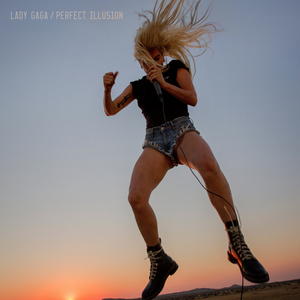

Жанр: pop
(300, 300)


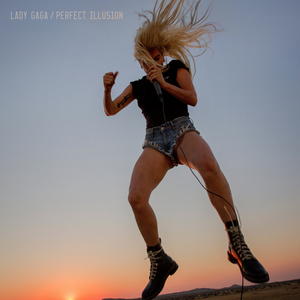

Жанр: classical
(300, 300)


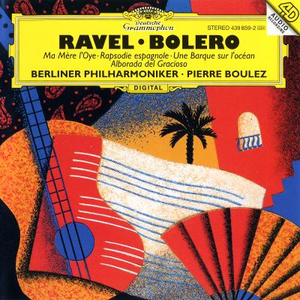

Жанр: classical
(300, 300)


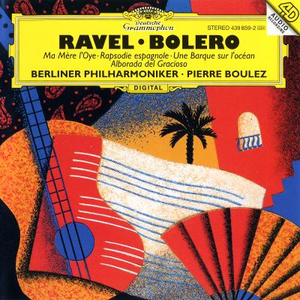

Жанр: classical
(300, 300)


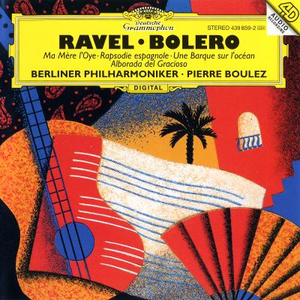

Жанр: edm
(300, 300)


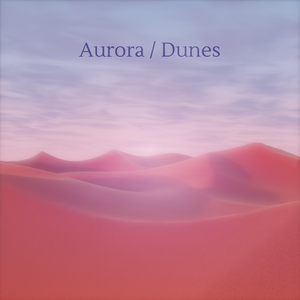

Жанр: edm
(300, 300)


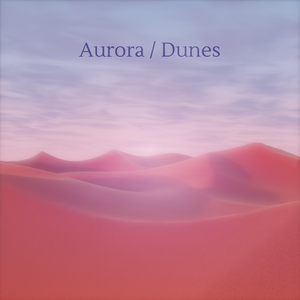

Жанр: pop
(300, 300)


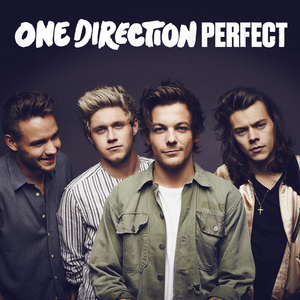

Жанр: pop
(300, 300)


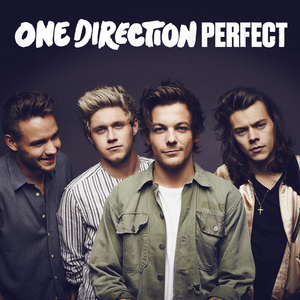

Жанр: anime
(300, 300)


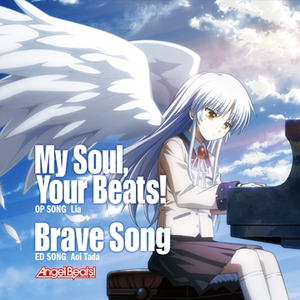

Жанр: anime
(300, 300)


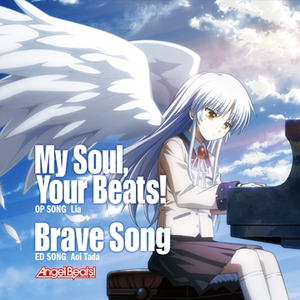

Жанр: pop
(300, 300)


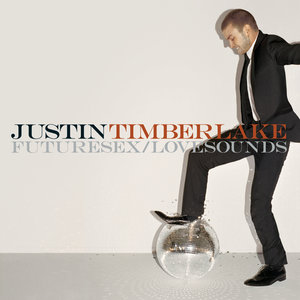

In [120]:
for i in range(0, data_duplicated.shape[0]-1):
    image_name = data_duplicated.iloc[[i]].index[0]
    img_genre = data_duplicated.iloc[i]['target']
#     img = Image.open(path + img_genre + '/' + img_genre + '/' + image_name).convert('RGB')
    img = Image.open(image_name).convert('RGB')
    print(f'Жанр: {img_genre}')
    print(img.size)
    display(img)

Получим список изображений дубликатов.

In [23]:
dupl_list = df_img[df_img.duplicated(keep='first')].index.to_list()

In [24]:
df_img.shape

(7800, 2049)

In [25]:
df_img.drop_duplicates(keep='first', inplace=True)

In [26]:
df_img.shape

(7760, 2049)

In [31]:
dupl_list

['./anime/anime/054883a9-b2e2-4e52-ad52-c980ea768cf0.png',
 './anime/anime/16072b25-550c-43b3-9cd3-6f575ec0a0ee.png',
 './anime/anime/680519a3-9a87-428b-8d3b-c7ef4b005de6.png',
 './anime/anime/bf9fe9d3-9393-4d02-9e21-db866297241b.png',
 './anime/anime/e0f6f77d-b589-4370-aa16-975fa91f481e.png',
 './black metal/black metal/151a2a52-ffe7-35e1-9fa2-b03d1cd86fb7.png',
 './classical/classical/59e085a2-1b7f-4629-bbf5-d02244e05983.png',
 './classical/classical/8e012a89-4adf-4ac1-8837-a740d7da7d0f.png',
 './classical/classical/ce7a56b3-f52a-4ad0-81f1-7a5a041bcc34.png',
 './classical/classical/ff0f6253-00db-4472-85a9-8870ba4014b7.png',
 './country/country/62b6ad6f-919d-487e-8a93-2360ad45cb52.png',
 './country/country/c9e52ce6-963f-4891-94aa-8c3e19224d4e.png',
 './country/country/d727b7de-bc03-41a3-82eb-0ec306238543.png',
 './disco/disco/bd1392ee-f988-461a-8b35-2da8c856ce67.png',
 './disco/disco/cd93fa72-8f5a-4471-ae9a-8921987e1d1f.png',
 './edm/edm/18613466-5471-4b8e-8a46-388e297cb1dc.png',
 './

## Сохранение векторов

In [301]:
"./" + r'my_data_RESNET50.csv'

'./my_data_RESNET50.csv'

In [2]:
# df_img.to_csv(path + r'my_data.csv')
# df_img.to_csv(path + r'my_data_mini.csv')
df_img.to_csv(path + r'my_data_RESNET50.csv')
# df_img.to_csv(path + r'my_data_RESNET50_2.csv')




# path = "C:/Users/Katya/Desktop/ds_learning/masterskaya_3/"

NameError: name 'df_img' is not defined

In [514]:
# df_img = pd.read_csv(path + r'my_data.csv', index_col='image')
df_img = pd.read_csv(path + r'my_data_RESNET50.csv', index_col='image')

# df_img = pd.read_csv(path + r'my_data_mini.csv', index_col='image')

df_img.head()

,0,1,2,3,4,5,6,7,8,9,...,2039,2040,2041,2042,2043,2044,2045,2046,2047,target
image,,,,,,,,,,,,,,,,,,,,,
00095702-6b86-4bb1-880e-1e09e759a013.png,0.206014,0.013719,0.049659,0.025440,0.239821,0.105520,0.013550,0.202331,0.067909,0.008109,...,0.005250,0.000000,0.173698,0.030903,0.000000,0.011865,0.014338,0.0,0.000000,anime
0091bee3-a67a-457e-8c5f-b4a1055b1211.png,0.003967,0.000000,0.001536,0.050578,0.669092,0.000000,0.076952,0.795427,0.000000,0.058550,...,0.003525,0.169340,0.000000,0.000000,0.283309,0.063567,0.003434,0.0,0.019173,anime
00a9d688-337f-4807-83cd-596540f1683b.png,0.051324,0.000000,0.093014,0.443881,0.986939,0.044447,0.273377,0.548700,0.164716,0.000000,...,0.000000,0.000000,0.014138,0.000000,0.013032,0.000000,0.000000,0.0,0.110995,anime
00ddb3de-75db-4e27-ad3d-441a5dc95636.png,0.039618,0.179682,0.096209,0.000000,0.376749,0.032519,0.057986,0.009625,0.227785,0.000380,...,0.022648,0.120641,0.007919,0.028745,0.084568,0.074516,0.016802,0.0,0.016342,anime
00ec64ef-c6ab-4a63-91df-59ce8db4ea25.png,0.082114,0.002415,0.121753,0.000811,0.397554,0.000000,0.183582,0.173981,0.443419,0.000405,...,0.637867,0.055761,0.000000,0.000000,0.035134,0.057372,0.000000,0.0,0.000000,anime


In [20]:
# df_img.drop('Unnamed: 0', axis=1, inplace=True)
# df_img.reset_index(inplace=True)
# df_img['target'] = data['genre']
# df_img.set_index('image', inplace=True)
# df_img.head()

In [205]:
df_img.shape

(7796, 2049)

In [16]:
df_img

,0,1,2,3,4,5,6,7,8,9,...,2039,2040,2041,2042,2043,2044,2045,2046,2047,target
image,,,,,,,,,,,,,,,,,,,,,
00095702-6b86-4bb1-880e-1e09e759a013.png,0.206014,0.013719,0.049659,0.025440,0.239821,0.105520,0.013550,0.202331,0.067909,0.008109,...,0.005250,0.000000,0.173698,0.030903,0.000000,0.011865,0.014338,0.000000,0.000000,anime
0091bee3-a67a-457e-8c5f-b4a1055b1211.png,0.003967,0.000000,0.001536,0.050578,0.669092,0.000000,0.076952,0.795427,0.000000,0.058550,...,0.003525,0.169340,0.000000,0.000000,0.283309,0.063567,0.003434,0.000000,0.019173,anime
00a9d688-337f-4807-83cd-596540f1683b.png,0.051324,0.000000,0.093014,0.443881,0.986939,0.044447,0.273377,0.548700,0.164716,0.000000,...,0.000000,0.000000,0.014138,0.000000,0.013032,0.000000,0.000000,0.000000,0.110995,anime
00ddb3de-75db-4e27-ad3d-441a5dc95636.png,0.039618,0.179682,0.096209,0.000000,0.376749,0.032519,0.057986,0.009625,0.227785,0.000380,...,0.022648,0.120641,0.007919,0.028745,0.084568,0.074516,0.016802,0.000000,0.016342,anime
00ec64ef-c6ab-4a63-91df-59ce8db4ea25.png,0.082114,0.002415,0.121753,0.000811,0.397554,0.000000,0.183582,0.173981,0.443419,0.000405,...,0.637867,0.055761,0.000000,0.000000,0.035134,0.057372,0.000000,0.000000,0.000000,anime
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f7234528-903a-4b4f-a19f-2a87d60db665.png,0.013651,0.023498,0.058122,0.000000,1.081841,0.219530,0.000000,0.215569,0.012757,0.000000,...,0.010248,0.018859,0.015506,0.007682,0.042096,0.113623,0.001484,0.008464,0.009347,reggae
fb9530d1-039d-471f-b4bb-ddfa700b77f3.png,0.006884,0.002957,0.165822,0.121795,0.462774,0.038234,0.000000,0.222150,0.013661,0.040552,...,0.000000,0.018053,0.058146,0.000000,0.004064,0.121199,0.043731,0.159077,0.139922,reggae
fbc14ad1-cf7d-446d-970e-07ddf0dabeb7.png,0.000000,0.000216,0.000000,0.000000,1.002466,0.358114,0.015856,1.316594,0.013450,0.000000,...,0.037232,0.013497,0.027881,0.045779,0.018609,1.789109,0.000000,0.048319,0.001186,reggae


In [35]:
df_img['target'].unique()

array(['anime', 'black metal', 'classical'], dtype=object)

## Разделим данные на обучающие и тестовые

In [17]:
def split(df):

    target = df['target']
    features = df.drop(['target'], axis=1)
    
    features_train, features_test, target_train, target_test = train_test_split(features, target, test_size=0.25, 
                                                                                random_state=RANDOM_STATE, 
                                                                                stratify=target,
                                                                                shuffle = True)
    print('Размер обучающей выборки:', features_train.shape[0], 'строк - ', round(features_train.shape[0]/df.shape[0] * 100), "%")
    print('Размер тестовой выборки:', features_test.shape[0], 'строк - ', round(features_test.shape[0]/df.shape[0] * 100), "%")
    return features_train, target_train, features_test, target_test

In [18]:
features_train, target_train, features_test, target_test = split(df_img)

Размер обучающей выборки: 5820 строк -  75 %
Размер тестовой выборки: 1940 строк -  25 %


In [218]:
features_train

,0,1,2,3,4,5,6,7,8,9,...,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047
image,,,,,,,,,,,,,,,,,,,,,
be25a994-4bd6-4df4-b4c7-898c718be43d.png,0.000000,0.000000,0.013431,0.000000,0.073146,0.000000,0.006342,1.294041,0.028479,0.052928,...,0.000000,0.000000,0.061831,0.063330,0.000000,0.002960,0.181616,0.374317,0.000000,0.000000
4cdb0d3c-a3f9-474e-b6eb-7c934dea634e.png,0.011410,0.151333,0.007098,0.000146,0.806295,0.000000,0.532635,0.003897,0.206870,0.031457,...,0.010175,0.009305,0.000000,0.086839,0.000000,0.109004,0.032480,0.002689,0.000000,0.000000
760dfc5c-2479-41c4-95b4-f040458966f5.png,0.041564,0.026920,0.014778,0.284235,0.642360,0.002452,0.079093,0.530880,0.000000,0.009405,...,0.000000,0.010016,0.017981,0.261292,0.000000,0.001170,0.965128,0.061746,0.017186,0.003111
8b78b114-f9df-4a93-96c5-d44db4bb8c9a.png,0.053117,0.000000,0.167782,0.099670,1.179687,0.007652,0.022219,0.585608,0.089643,0.000000,...,0.000000,0.025713,0.008851,0.001301,0.000000,0.071077,0.203210,0.010635,0.082788,0.976023
bdabd70c-49df-4d67-9eae-3c4cb898f9e6.png,0.000000,0.000000,0.169936,0.025757,0.769302,0.160717,0.032356,0.744148,0.010641,0.002386,...,0.001964,0.018063,0.258366,0.044043,0.001156,0.451967,0.080076,0.004669,0.081114,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8db47ac8-f002-40f4-bc54-97930ee08690.png,0.437979,0.011219,0.013528,0.000000,1.097828,0.036615,0.093509,0.000000,0.025858,0.001591,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.014982,0.068684,0.000000,0.000000,0.004555
1a2cce0e-3ce9-4e87-b9b8-86cb0c7061a8.png,0.359290,0.000000,0.258971,0.000000,0.309875,0.011576,0.000000,0.022947,0.236648,0.010330,...,0.000000,0.000000,0.120504,0.000665,0.000000,0.020081,0.000745,0.000000,0.000000,0.012695
449fe3cb-1ced-45bc-8a7a-8c8d5b2ececd.png,0.000000,0.002338,0.010990,0.046614,0.090517,0.022589,0.056407,0.019727,0.999692,0.005427,...,0.010282,0.000000,0.004515,0.026067,0.000000,0.000000,0.000000,0.030864,0.000000,0.111735


In [40]:
target_train.value_counts(normalize=True)

target
anime          0.458204
classical      0.367905
black metal    0.173891
Name: proportion, dtype: float64

In [41]:
target_test.value_counts(normalize=True)

target
anime          0.458204
classical      0.368421
black metal    0.173375
Name: proportion, dtype: float64

## Масштабирование

In [11]:
# %%time
# scaler = StandardScaler()
# scaler.fit(features_train[features_train.columns])
# features_train[features_train.columns] = scaler.transform(features_train[features_train.columns])
# features_test[features_test.columns] = scaler.transform(features_test[features_test.columns])
# features_test[features_test.columns] = scaler.transform(features_test[features_test.columns])

## DummyClassifier

In [81]:
dummy_clf = DummyClassifier(strategy="most_frequent")
dummy_clf.fit(features_train, target_train)
dummy_clf.score(features_test, target_test)

0.19123711340206184

In [82]:
dummy_clf = DummyClassifier(strategy="uniform")
dummy_clf.fit(features_train, target_train)
dummy_clf.score(features_test, target_test)

0.10618556701030928

In [83]:
dummy_clf = DummyClassifier(strategy="prior")
dummy_clf.fit(features_train, target_train)
dummy_clf.score(features_test, target_test)

0.19123711340206184

In [84]:
dummy_clf = DummyClassifier(strategy="stratified")
dummy_clf.fit(features_train, target_train)
dummy_clf.score(features_test, target_test)

0.10876288659793815

## KNN

In [ ]:
(n_neighbors=5, *, weights='uniform', algorithm='auto', leaf_size=30, p=2, metric='minkowski', metric_params=None, n_jobs=None)

In [64]:
from sklearn.neighbors import KNeighborsClassifier
neigh = KNeighborsClassifier(n_neighbors=3)#, weights='distance')#'distance'

In [105]:
neigh.fit(features_train, target_train)

KNeighborsClassifier(n_neighbors=3)

In [88]:
neigh.predict(features_test)

array(['black metal', 'anime', 'classical', ..., 'country', 'classical',
       'anime'], dtype=object)

In [86]:
neigh.classes_

array(['anime', 'black metal', 'classical', 'country', 'disco', 'edm',
       'jazz', 'pop', 'rap', 'reggae'], dtype=object)

In [74]:
neigh.predict_proba(df_img_test)[0]

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.66666667, 0.        , 0.        , 0.33333333, 0.        ])

In [82]:
pd.DataFrame(neigh.classes_, neigh.predict_proba(df_img_test)[0]).sort_index(ascending=False).head(3).values

TypeError: 'numpy.ndarray' object is not callable

In [62]:
X = [[0], [1], [2], [3]]
y = [0, 0, 1, 1]

neigh = KNeighborsClassifier(n_neighbors=3)
neigh.fit(X, y)

print(neigh.predict([[1.1]]))

print(neigh.predict_proba([[0.9]]))


[0]
[[0.66666667 0.33333333]]


In [51]:
import joblib

joblib.dump(neigh, "model.pkl")

['model.pkl']

In [52]:
neigh_2 = joblib.load("model.pkl")

In [53]:
neigh.fit(features_train, target_train)
preds = neigh.predict(features_test)

preds

array(['black metal', 'anime', 'classical', ..., 'country', 'classical',
       'anime'], dtype=object)

In [ ]:
f1_score(target_test, preds, average='weighted')

In [220]:
df_img['target'].unique()

array(['anime', 'black metal', 'classical', 'country', 'disco', 'edm',
       'jazz', 'pop', 'rap', 'reggae'], dtype=object)

In [82]:
neigh.fit(features_train, target_train)

KNeighborsClassifier(n_neighbors=3)

In [84]:
preds = neigh.predict(features_test)
len(preds)

1940

In [45]:
preds

array(['anime', 'classical', 'classical', 'classical', 'classical',
       'classical', 'anime', 'black metal', 'classical', 'black metal',
       'anime', 'anime', 'anime', 'classical', 'anime', 'classical',
       'black metal', 'classical', 'anime', 'anime', 'anime', 'classical',
       'anime', 'black metal', 'classical', 'anime', 'classical',
       'classical', 'classical', 'anime', 'classical', 'anime', 'anime',
       'classical', 'anime', 'anime', 'classical', 'anime', 'anime',
       'anime', 'black metal', 'anime', 'anime', 'black metal', 'anime',
       'anime', 'anime', 'anime', 'anime', 'anime', 'anime', 'classical',
       'anime', 'anime', 'classical', 'classical', 'anime', 'classical',
       'anime', 'classical', 'black metal', 'classical', 'anime',
       'classical', 'classical', 'classical', 'anime', 'anime',
       'black metal', 'anime', 'anime', 'anime', 'anime', 'classical',
       'anime', 'classical', 'anime', 'classical', 'black metal',
       'classical', '

In [46]:
neigh.predict_proba(features_test)[1]

array([0., 0., 1.])

In [47]:
print(neigh.predict_proba(features_test))

[[1. 0. 0.]
 [0. 0. 1.]
 [0. 0. 1.]
 ...
 [0. 0. 1.]
 [0. 0. 1.]
 [1. 0. 0.]]


In [85]:
list(target_train.unique())

['pop',
 'anime',
 'black metal',
 'jazz',
 'edm',
 'classical',
 'country',
 'reggae',
 'disco',
 'rap']

In [86]:
# target_names = list(target_train['genre'].unique())
target_names = list(target_train.unique())
print(classification_report(target_test, preds, target_names=target_names))

              precision    recall  f1-score   support

         pop       0.53      0.81      0.64       296
       anime       0.65      0.73      0.69       112
 black metal       0.44      0.76      0.56       238
        jazz       0.51      0.54      0.52       371
         edm       0.34      0.22      0.27       116
   classical       0.66      0.26      0.38       175
     country       0.34      0.31      0.32       205
      reggae       0.44      0.27      0.33       200
       disco       0.78      0.26      0.39        82
         rap       0.47      0.25      0.33       145

    accuracy                           0.49      1940
   macro avg       0.52      0.44      0.44      1940
weighted avg       0.50      0.49      0.47      1940



In [223]:
# target_names = list(target_train['genre'].unique())
target_names = list(target_train.unique())
print(classification_report(target_test, preds, target_names=target_names))

              precision    recall  f1-score   support

       anime       0.51      0.82      0.63       296
 black metal       0.65      0.73      0.69       112
     country       0.45      0.76      0.57       238
         pop       0.52      0.55      0.53       371
        jazz       0.32      0.22      0.26       116
         rap       0.58      0.26      0.36       175
   classical       0.38      0.32      0.35       205
       disco       0.42      0.25      0.31       200
      reggae       0.65      0.18      0.29        82
         edm       0.61      0.30      0.40       144

    accuracy                           0.49      1939
   macro avg       0.51      0.44      0.44      1939
weighted avg       0.50      0.49      0.47      1939



In [87]:
f1_score(target_test, preds, average='weighted')

0.46504807368766715

In [224]:
f1_score(target_test, preds, average='weighted')

0.46674228477729157

In [232]:
accuracy_score(target_test, preds)

0.4925219185146983

In [88]:
accuracy_score(target_test, preds)

0.48917525773195875

              precision    recall  f1-score   support

   classical       0.92      0.92      0.92       296
       anime       0.95      0.79      0.86       112
 black metal       0.88      0.94      0.91       238

    accuracy                           0.91       646
   macro avg       0.91      0.88      0.90       646
weighted avg       0.91      0.91      0.90       646

'              precision    recall  f1-score   support\n\n   classical       0.92      0.92      0.92       296\n       anime       0.95      0.79      0.86       112\n black metal       0.88      0.94      0.91       238\n\n    accuracy                           0.91       646\n   macro avg       0.91      0.88      0.90       646\nweighted avg       0.91      0.91      0.90       646\n'

In [60]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

In [61]:
neigh.classes_

array(['anime', 'black metal', 'classical'], dtype=object)

In [63]:
import matplotlib as plt

In [ ]:
# target_names = list(target_train['genre'].unique())
target_names = list(target_train.unique())
print(classification_report(target_test, preds, target_names=target_names))

In [226]:
for title, normalize in titles_options:
    print(title)
    print(normalize)

Confusion matrix, without normalization
None
Normalized confusion matrix
true


Confusion matrix, without normalization
Normalized confusion matrix


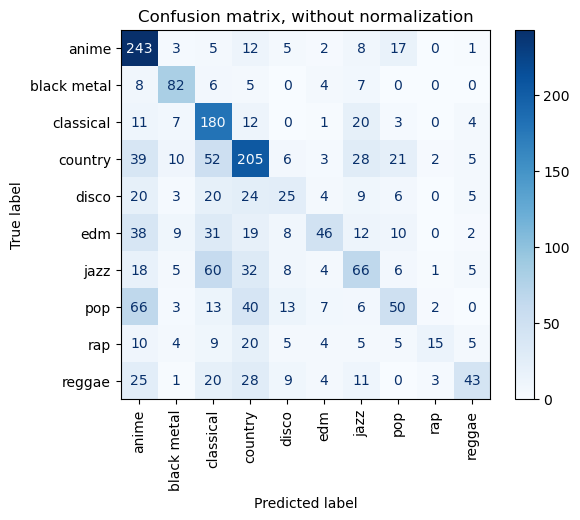

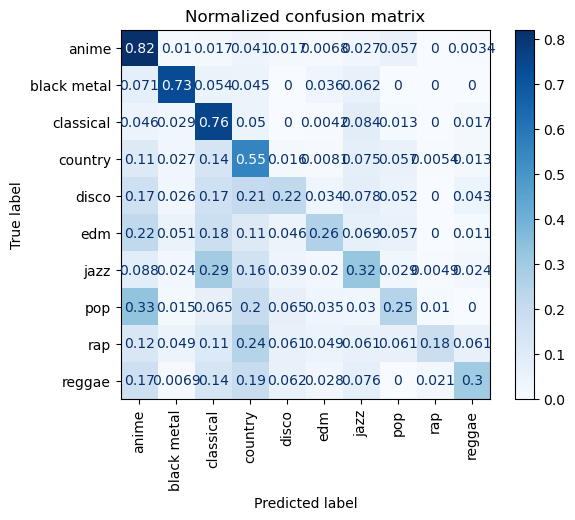

In [234]:
# Plot non-normalized confusion matrix
titles_options = [
    ("Confusion matrix, without normalization", None),
    ("Normalized confusion matrix", "true"),
]
for title, normalize in titles_options:
    disp = ConfusionMatrixDisplay.from_estimator(
        neigh,
        features_test,
        target_test,
        display_labels=neigh.classes_,
        cmap=plt.cm.Blues,
        normalize=normalize,
        xticks_rotation="vertical"
    )
    disp.ax_.set_title(title)

    print(title)

# plt.show()

In [235]:
df_img['target'].value_counts()

target
country        1483
anime          1184
classical       951
jazz            819
pop             799
edm             702
reggae          575
disco           466
black metal     449
rap             328
Name: count, dtype: int64

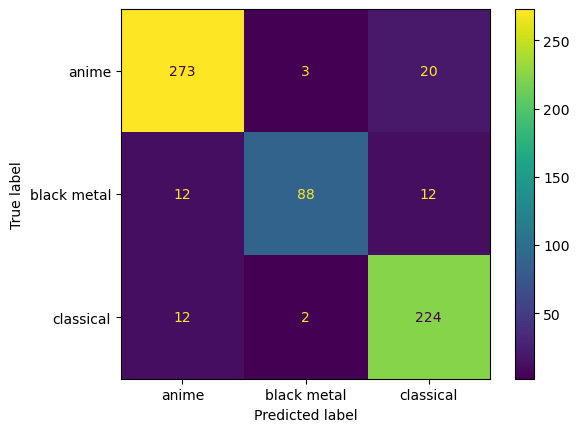

In [69]:
cm = confusion_matrix(target_test, preds, labels=neigh.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=neigh.classes_)
disp.plot();

In [59]:
confusion_matrix(target_test, preds)

array([[273,   3,  20],
       [ 12,  88,  12],
       [ 12,   2, 224]], dtype=int64)

In [ ]:
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
X, y = make_classification(random_state=0)
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    random_state=0)
clf = SVC(random_state=0)
clf.fit(X_train, y_train)
predictions = clf.predict(X_test)
cm = confusion_matrix(y_test, predictions, labels=clf.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=clf.classes_)
disp.plot()
plt.show()

In [50]:
classification_report_LG = classification_report(target_test, preds, target_names=target_names)
classification_report_LG

'              precision    recall  f1-score   support\n\n   classical       0.92      0.92      0.92       296\n       anime       0.95      0.79      0.86       112\n black metal       0.88      0.94      0.91       238\n\n    accuracy                           0.91       646\n   macro avg       0.91      0.88      0.90       646\nweighted avg       0.91      0.91      0.90       646\n'

In [51]:
pandas_df_to_markdown_table(classification_report_LG)

NameError: name 'pandas_df_to_markdown_table' is not defined

In [54]:
# Функция для преобразования dataframe в Markdown Table
def pandas_df_to_markdown_table(df):
    from IPython.display import Markdown, display
    fmt = ['---' for i in range(len(df.columns))]
    df_fmt = pd.DataFrame([fmt], columns=df.columns)
    df_formatted = pd.concat([df_fmt, df])
    display(Markdown(df_formatted.to_csv(sep="|", index=False)))

pandas_df_to_markdown_table(classification_report_LG)

AttributeError: 'str' object has no attribute 'columns'

In [22]:
accuracy_score(target_test, preds)

0.46494845360824744

In [57]:
target_names = list(data['genre'].unique())
print(classification_report(target_test, preds, target_names=target_names))

              precision    recall  f1-score   support

       anime       0.54      0.78      0.64       296
 black metal       0.56      0.76      0.64       112
   classical       0.42      0.76      0.54       238
     country       0.45      0.59      0.51       371
       disco       0.22      0.09      0.12       116
         edm       0.60      0.26      0.37       175
        jazz       0.36      0.21      0.27       205
         pop       0.43      0.21      0.28       200
         rap       0.61      0.13      0.22        82
      reggae       0.40      0.23      0.29       145

    accuracy                           0.46      1940
   macro avg       0.46      0.40      0.39      1940
weighted avg       0.46      0.46      0.43      1940



In [58]:
from sklearn.metrics import accuracy_score

In [51]:
accuracy_score(target_test, preds)

NameError: name 'accuracy_score' is not defined

## knn gridsearch

In [52]:
from sklearn.model_selection import GridSearchCV


In [301]:
k_range = list(range(1, 31))
print(k_range)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [302]:
k_range = list(range(1, 31))
weight_options = ['uniform', 'distance']
param_grid = dict(n_neighbors=k_range, weights=weight_options)
print(param_grid)

{'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30], 'weights': ['uniform', 'distance']}


In [303]:
X=features_train
y=target_train

In [304]:
knn = KNeighborsClassifier(n_jobs=-1)
grid = GridSearchCV(knn, param_grid, cv=10, scoring='accuracy', return_train_score=False)
grid.fit(X, y)

GridSearchCV(cv=10, estimator=KNeighborsClassifier(n_jobs=-1),
             param_grid={'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                         13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
                                         23, 24, 25, 26, 27, 28, 29, 30],
                         'weights': ['uniform', 'distance']},
             scoring='accuracy')

In [305]:
grid_mean_scores = grid.cv_results_['mean_test_score']
print(grid_mean_scores)

[0.47481709 0.47481709 0.47361493 0.47447315 0.49458245 0.50266397
 0.51142774 0.52122895 0.52087821 0.52930603 0.52638418 0.53669642
 0.53205576 0.53875916 0.52999095 0.538417   0.53136877 0.54168485
 0.53240029 0.54047885 0.53532333 0.54288672 0.53566726 0.54202613
 0.53687208 0.5420285  0.53498205 0.54237332 0.53154414 0.53945354
 0.53257803 0.54392149 0.53257714 0.54323479 0.53566756 0.5420285
 0.53394609 0.53910546 0.53429269 0.5394494  0.5325733  0.53790419
 0.53480697 0.54082663 0.53669642 0.5392764  0.53411732 0.54202643
 0.5337722  0.54082338 0.53119695 0.53893423 0.53137025 0.53996723
 0.53102336 0.53669937 0.5330864  0.53824488 0.53188128 0.5375573 ]


In [306]:
plt.plot(k_range, grid_mean_scores)
plt.xlabel('Value of K for KNN')
plt.ylabel('Cross-Validated Accuracy')

AttributeError: module 'matplotlib' has no attribute 'plot'

In [311]:
grid.best_estimator_

KNeighborsClassifier(n_jobs=-1, n_neighbors=16, weights='distance')

In [308]:
accuracy_score(target_test, grid.predict(features_test))

0.555440948942754

In [309]:
grid.best_score_

0.5439214886053788

In [310]:
accuracy_score(target_test, grid.predict(features_test))

0.555440948942754

In [59]:
target_names = list(data['genre'].unique())
print(classification_report(target_test, grid.predict(features_test), target_names=target_names))

              precision    recall  f1-score   support

       anime       0.94      0.94      0.94       296
 black metal       0.94      0.83      0.88       112
   classical       0.89      0.94      0.92       238

    accuracy                           0.92       646
   macro avg       0.92      0.90      0.91       646
weighted avg       0.92      0.92      0.92       646



In [60]:
grid.best_params_

{'n_neighbors': 10, 'weights': 'distance'}

In [133]:
%%time

knn = KNeighborsClassifier(n_jobs=-1)
knn_params = {'n_neighbors': range(1, 10)}
knn_grid = GridSearchCV(knn, knn_params, cv=10, n_jobs=-1, verbose=False)

knn_grid.fit(features_train, target_train)


CPU times: total: 9.41 s
Wall time: 11 s


GridSearchCV(cv=10, estimator=KNeighborsClassifier(n_jobs=-1), n_jobs=-1,
             param_grid={'n_neighbors': range(1, 10)}, verbose=False)

In [134]:
knn_grid.best_params_, knn_grid.best_score_, accuracy_score(target_test, knn_grid.predict(features_test))

({'n_neighbors': 9}, 0.47577319587628863, 0.4036082474226804)

In [ ]:
%%time
feature_importances = pd.DataFrame({'features': df.columns, 'importance':tree_grid.best_estimator_.feature_importances_})
print(feature_importances.sort_values(by=['importance'], inplace=False, ascending=False))

scaler = StandardScaler().fit(X_train)
X_train_transformed = scaler.transform(X_train)
X_train_transformed = X_train_transformed * np.array(feature_importances['importance'])

X_holdout_transformed = scaler.transform(X_holdout)
X_holdout_transformed = X_holdout_transformed * np.array(feature_importances['importance'])

knn_grid = GridSearchCV(KNeighborsClassifier(n_jobs=-1), {'n_neighbors': range(1, 11, 2)}, cv=5, n_jobs=-1, verbose=False)
knn_grid.fit(X_train_transformed, y_train)
print (knn_grid.best_params_, knn_grid.best_score_, accuracy_score(y_holdout, knn_grid.predict(X_holdout_transformed)))


## Faiss

In [ ]:
# vectors = np.ascontiguousarray(features_train.values).astype('float32')
vectors = features_train.values

In [ ]:
# query = np.ascontiguousarray(train.values).astype('float32')
query = features_test.values

### IndexFlatL2

In [499]:
dim = features_train.shape[1]
index = faiss.IndexFlatL2(dim) 

In [500]:
%%time

print(index.is_trained)
index.add(vectors)
print(index.ntotal)

True
5820
CPU times: total: 62.5 ms
Wall time: 39.2 ms


In [501]:
%%time

k = 3
D, I = index.search(query, k)

CPU times: total: 25.8 s
Wall time: 16.2 s


In [502]:
preds = [target_train.iloc[i][0] for i in I.tolist()]

In [503]:
preds

['black metal',
 'anime',
 'disco',
 'jazz',
 'country',
 'anime',
 'anime',
 'anime',
 'country',
 'black metal',
 'jazz',
 'country',
 'edm',
 'reggae',
 'country',
 'reggae',
 'pop',
 'country',
 'edm',
 'edm',
 'classical',
 'rap',
 'jazz',
 'classical',
 'disco',
 'classical',
 'anime',
 'pop',
 'anime',
 'pop',
 'anime',
 'anime',
 'jazz',
 'jazz',
 'classical',
 'edm',
 'disco',
 'classical',
 'classical',
 'pop',
 'anime',
 'pop',
 'country',
 'pop',
 'disco',
 'rap',
 'anime',
 'edm',
 'pop',
 'reggae',
 'classical',
 'rap',
 'country',
 'rap',
 'classical',
 'anime',
 'black metal',
 'black metal',
 'classical',
 'country',
 'reggae',
 'pop',
 'anime',
 'black metal',
 'country',
 'country',
 'country',
 'reggae',
 'country',
 'classical',
 'pop',
 'jazz',
 'pop',
 'anime',
 'country',
 'anime',
 'country',
 'edm',
 'country',
 'anime',
 'country',
 'anime',
 'pop',
 'country',
 'jazz',
 'anime',
 'classical',
 'country',
 'edm',
 'edm',
 'black metal',
 'anime',
 'pop',
 'an

In [ ]:
accuracy_score(preds, list(target_test.values))

In [ ]:
target_names = list(target_test.unique())
print(classification_report(target_test, preds, target_names=target_names))

In [ ]:
f1_score(target_test, preds, average='weighted')

In [ ]:
#how many partitions we’d like our index to have
dim = features_train.shape[1]

nlist = 500 # количество кластеров 141
quantizer = faiss.IndexFlatL2(dim) 
#quantiser = faiss.IndexFlatIP(dim)
index = faiss.IndexIVFFlat(quantizer, dim, nlist, faiss.METRIC_L2) #METRIC_INNER_PRODUCT

In [ ]:
%%time


#Запускаем обучение:
print(index.is_trained)   # False.
index.train(vectors)  # Train на нашем наборе векторов
 
# Обучение завершено, но векторов в индексе пока нет, так что добавляем их в индекс:
print(index.is_trained)  # True
print(index.ntotal)   # 0
index.add(vectors)
print(index.ntotal)   # 1000000

In [ ]:

index.nprobe = 40 #int(math.sqrt(base_mini.shape[0]))  # Проходим по топ-16 центроид для поиска top-n ближайших соседей
D, I = index.search(query, 1) 

In [ ]:
preds = [target_train.iloc[i][0] for i in I.tolist()]

In [ ]:
accuracy_score(preds, list(target_test.values))

In [ ]:
target_names = list(target_test.unique())
print(classification_report(target_test, preds, target_names=target_names))

In [ ]:
acc = 0
for target, el in zip(target_test.values.tolist(), I.tolist()):
    acc += int(target in [base_index[i] for i in el])

acc_IndexFlatL2 = 100 * acc / len(I)
print(acc_IndexFlatL2, "%")

In [ ]:
target_train.iloc[1240]

### IndexIVFFlat

In [398]:
# vectors = np.ascontiguousarray(features_train.values).astype('float32')
vectors = features_train.values

In [399]:
# query = np.ascontiguousarray(train.values).astype('float32')
query = features_test.values

In [400]:
def get_preds(target_test, I):
    predictions = []
    for target, el in zip(target_test.values.tolist(), I.tolist()):
        predictions.append(stat.mode([target_train.iloc[i] for i in el]))
    acc = accuracy_score(predictions, list(target_test.values))
    return acc

In [401]:
dim = features_train.shape[1]
quantizer = faiss.IndexFlatL2(dim) 
# quantizer = faiss.IndexFlatIP(dim)

In [454]:
%%time

nprobe = 10
topn = 15
nlist = 100


index = faiss.IndexIVFFlat(quantizer, dim, nlist, faiss.METRIC_L2) #METRIC_INNER_PRODUCT
index.train(vectors)
index.add(vectors)
        

index.nprobe = nprobe      
D, I = index.search(query, topn) 
            
acc = get_preds(target_test, I)
acc

CPU times: total: 10.1 s
Wall time: 1.4 s


0.5494845360824743

### Работа с предсказаниями

In [422]:
from math import sqrt

In [423]:
df_group

,mean,count,final
target,,,
black metal,0.452321,2,4.421640
classical,0.438215,1,2.281984
edm,0.445117,2,4.493202


In [449]:
df_group['mean'].apply(lambda x: x**0.2)

target
black metal    0.853276
classical      0.847886
edm            0.850540
Name: mean, dtype: float64

In [450]:
df

,index,distance,target
0,1524,0.410826,edm
1,1129,0.438215,classical
2,1222,0.443115,black metal
3,1081,0.461526,black metal
4,1084,0.479407,edm


In [476]:
df['distance'] = 15/16 * (1-df['distance']**2)**2
df

,index,distance,target
0,1524,0.647746,edm
1,1129,0.612011,classical
2,1222,0.605486,black metal
3,1081,0.580649,black metal
4,1084,0.556087,edm


In [494]:
def get_prediction(target_test, I, D):
    result=[]
    for target, el, dist in zip(target_test.values.tolist(), I.tolist(), D):
#         print([target_train.iloc[i] for i in el])
#         print(target, el, dist)
        df = pd.DataFrame({'index': el,
                           'distance': dist,
                           'target': [target_train.iloc[i] for i in el]})
#         display(df)
        df['distance'] = preprocessing.normalize([df['distance']])[0]
#         display(df)
        df_group = df.groupby('target')['distance'].agg(['mean', 'count'])
#         display(df_group)
#         df_group['final'] = df_group['mean'] * df_group['count']
        df_group['final'] = df_group['count'] / (df_group['mean'])
#         df_group['final'] = df_group['count'] * (3/4 * (1-df_group['mean']**2))
#         df_group['final'] = df_group['count'] * (15/16 * (1-df_group['mean']**2)**2)


#         display(df_group)
#         result = df_group.sort_values('final').head(1).index[0]
#         print(result)
        result.append(df_group.sort_values('final').tail(1).index[0])
    return result

In [495]:
x=0.1
3/4 * (1-x**2)

0.7424999999999999

In [496]:
x=0.4
3/4 * (1-x**2)

0.63

In [497]:
predictions = get_prediction(target_test, I, D)

In [498]:
accuracy_score(target_test, predictions)

0.55

In [295]:
a = 11
b = a + 2
display(features_test.iloc[a:b])
# print('Значение таргета:', target_test.iloc[a:b][0])
query = features_test.iloc[a:b].values
D, I = index.search(query, topn)

for target, el, dist in zip(target_test.iloc[a:b].values.tolist(), I.tolist(), D):
    print([target_train.iloc[i] for i in el])
    print(target, el, dist)
    df = pd.DataFrame({'index': el,
                       'distance': dist,
                       'target': [target_train.iloc[i] for i in el]})
    display(df)

,0,1,2,3,4,5,6,7,8,9,...,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047
image,,,,,,,,,,,,,,,,,,,,,
dd55b949-208d-42ae-b217-b46d1d6c4adf.png,0.094907,0.022705,0.000200,0.039693,0.184522,0.0,0.000000,3.067046,0.0,0.006619,...,0.001772,0.0,0.002560,0.00000,0.002312,0.000000,0.650979,0.000000,0.014367,0.015857
3796e346-e40b-4334-b306-b8cf96dafcd2.png,0.011418,0.102050,0.038088,0.000000,0.665947,0.0,0.106676,0.006335,0.0,0.001739,...,0.005569,0.0,0.018687,0.05365,0.000000,0.021655,0.085577,0.050108,0.000000,0.063622


['country', 'disco', 'country', 'classical', 'country']
country [4218, 1665, 5141, 2623, 3308] [ 96.2572    98.44757   99.29935  100.74665  101.798065]


,index,distance,target
0,4218,96.257202,country
1,1665,98.447571,disco
2,5141,99.299347,country
3,2623,100.746651,classical
4,3308,101.798065,country


['edm', 'classical', 'black metal', 'black metal', 'edm']
jazz [1524, 1129, 1222, 1081, 1084] [ 92.82105  99.00917 100.11633 104.27606 108.31602]


,index,distance,target
0,1524,92.821053,edm
1,1129,99.009171,classical
2,1222,100.116333,black metal
3,1081,104.276062,black metal
4,1084,108.316017,edm


,index,distance,target
0,1524,92.821053,edm
1,1129,99.009171,classical
2,1222,100.116333,black metal
3,1081,104.276062,black metal
4,1084,108.316017,edm


In [378]:
a = 12
b = a + 1
display(features_test.iloc[a:b])
print('Значение таргета:', target_test.iloc[a:b][0])
query = features_test.iloc[a:b].values
D, I = index.search(query, topn)

for target, el, dist in zip(target_test.iloc[a:b].values.tolist(), I.tolist(), D):
    print([target_train.iloc[i] for i in el])
    print(target, el, dist)
    df = pd.DataFrame({'index': el,
                       'distance': dist,
                       'target': [target_train.iloc[i] for i in el]})
    print(target)
df

,0,1,2,3,4,5,6,7,8,9,...,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047
image,,,,,,,,,,,,,,,,,,,,,
3796e346-e40b-4334-b306-b8cf96dafcd2.png,0.011418,0.10205,0.038088,0.0,0.665947,0.0,0.106676,0.006335,0.0,0.001739,...,0.005569,0.0,0.018687,0.05365,0.0,0.021655,0.085577,0.050108,0.0,0.063622


Значение таргета: jazz
['edm', 'classical', 'black metal', 'black metal', 'edm']
jazz [1524, 1129, 1222, 1081, 1084] [ 92.82105  99.00917 100.11633 104.27606 108.31602]
jazz


,index,distance,target
0,1524,92.821053,edm
1,1129,99.009171,classical
2,1222,100.116333,black metal
3,1081,104.276062,black metal
4,1084,108.316017,edm


In [379]:
# Мин-макс нормализацию можно вычислить простым способом, учтите знаки операций
# df['norm'] = (df['distance'] - df['distance'].min()) / (df['distance'].max() - df['distance'].min())

In [380]:
df

,index,distance,target
0,1524,92.821053,edm
1,1129,99.009171,classical
2,1222,100.116333,black metal
3,1081,104.276062,black metal
4,1084,108.316017,edm


In [381]:
df['distance'] = preprocessing.normalize([df['distance']])[0]

In [382]:
df

,index,distance,target
0,1524,0.410826,edm
1,1129,0.438215,classical
2,1222,0.443115,black metal
3,1081,0.461526,black metal
4,1084,0.479407,edm


In [383]:
df_group = df.groupby('target')['distance'].agg(['mean', 'count'])
df_group

,mean,count
target,,
black metal,0.452321,2
classical,0.438215,1
edm,0.445117,2


In [391]:
df_group['final'] = df_group['count'] / df_group['mean']
df_group

,mean,count,final
target,,,
black metal,0.452321,2,4.421640
classical,0.438215,1,2.281984
edm,0.445117,2,4.493202


In [392]:
df_group.sort_values(['count', 'final'])

,mean,count,final
target,,,
classical,0.438215,1,2.281984
black metal,0.452321,2,4.421640
edm,0.445117,2,4.493202


In [393]:
df_group.sort_values('final').tail(1).index[0]

'edm'

,0,1,2,3,4,5,6,7,8,9,...,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047
image,,,,,,,,,,,,,,,,,,,,,
b185ec82-d596-4b5f-8e2f-2360d72065fb.png,0.005913,0.009774,0.804808,0.000000,0.884965,0.000000,0.093408,0.091705,0.126244,0.002344,...,0.0,0.000175,0.0,0.000836,0.000000,0.002531,0.000000,0.003619,0.047007,0.000000
8078764c-47f2-4068-8721-adf48afb2215.png,0.402286,0.030072,0.524912,0.097481,0.477246,0.007014,0.156991,0.316568,0.329190,0.083025,...,0.0,0.038278,0.0,0.062971,0.059311,0.038571,0.032137,0.036378,0.000000,0.435625


Значение таргета: black metal


In [323]:
# for target, el, dist in zip(target_test.iloc[a:b].values.tolist(), I.tolist(), D):
#     print([target_train.iloc[i] for i in el])
#     print(target, el, dist)
#     df = pd.DataFrame({'index': el,
#                        'distance': dist,
#                        'target': [target_train.iloc[i] for i in el]})
#     display(df)
#     df['distance'] = preprocessing.normalize([df['distance']])[0]
#     display(df)
#     df_group = df.groupby('target')['distance'].agg(['mean', 'count'])
#     display(df_group)
#     df_group['final'] = df_group['mean'] * df_group['count']
#     display(df_group)
#     result = df_group.sort_values('final').head(1).index[0]
#     print(result)

In [345]:
a = 0
b = a + 2
display(features_test.iloc[a:b])
print('Значение таргета:', target_test.iloc[a:b][0])
query = features_test.iloc[a:b].values
D, I = index.search(query, topn)



,0,1,2,3,4,5,6,7,8,9,...,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047
image,,,,,,,,,,,,,,,,,,,,,
b185ec82-d596-4b5f-8e2f-2360d72065fb.png,0.005913,0.009774,0.804808,0.000000,0.884965,0.000000,0.093408,0.091705,0.126244,0.002344,...,0.0,0.000175,0.0,0.000836,0.000000,0.002531,0.000000,0.003619,0.047007,0.000000
8078764c-47f2-4068-8721-adf48afb2215.png,0.402286,0.030072,0.524912,0.097481,0.477246,0.007014,0.156991,0.316568,0.329190,0.083025,...,0.0,0.038278,0.0,0.062971,0.059311,0.038571,0.032137,0.036378,0.000000,0.435625


Значение таргета: black metal


In [57]:
predictions = []
for target, el in zip(sample.values.tolist(), I.tolist()):
    predictions.append(stat.mode([target_train.iloc[i] for i in el]))
# acc = accuracy_score(predictions, list(target_test.values))
predictions

['black metal']

In [74]:
target_train.iloc[394]

'black metal'

In [ ]:
def get_preds(target_test, I):
    predictions = []
    for target, el in zip(target_test.values.tolist(), I.tolist()):
        predictions.append(stat.mode([target_train.iloc[i] for i in el]))
    acc = accuracy_score(predictions, list(target_test.values))
    return acc

In [ ]:
dim = features_train.shape[1]
quantizer = faiss.IndexFlatL2(dim) 
#quantiser = faiss.IndexFlatIP(dim)

In [ ]:
index.nprobe = 40
topn = 15
nlist_s = 1000

index = faiss.IndexIVFFlat(quantizer, dim, nlist, faiss.METRIC_L2) #METRIC_INNER_PRODUCT
index.train(vectors)
index.add(vectors)

D, I = index.search(query, topn)
acc = get_preds(target_test, I)
acc

In [ ]:
%%time

nlist_list = []
nprobe_list = []
acc_list = []
topn_list = []

for topn in [5, 10, 15, 20]:

    for nlist_s in [100, 500, 1000]:
        nlist = nlist_s
        index = faiss.IndexIVFFlat(quantizer, dim, nlist, faiss.METRIC_L2) #METRIC_INNER_PRODUCT
        index.train(vectors)
        index.add(vectors)
        

        for nprobe_s in [5, 10, 40]:
            index.nprobe = nprobe_s       
            D, I = index.search(query, topn) 
            
            acc = get_preds(target_test, I)
            
            nlist_list.append(nlist_s)
            nprobe_list.append(nprobe_s)
            acc_list.append(acc)
            topn_list.append(topn)
        
            
            
            print(nlist_s, nprobe_s, acc_list)

In [ ]:
#convert lists into a single list
data = []
data.append(nlist_list)
data.append(nprobe_list)
data.append(acc_list)
data.append(topn_list)

#convert list into DataFrame
df = pd.DataFrame(data).transpose()
df.columns =['nlist', 'nprobe', 'acc', 'topn']

#view resulting DataFrame
df

In [ ]:
df[df['acc'] == df['acc'].max()]

In [ ]:
#convert lists into a single list
data = []
data.append(nlist_list)
data.append(nprobe_list)
data.append(acc_list)
data.append(topn_list)

#convert list into DataFrame
df = pd.DataFrame(data).transpose()
df.columns =['nlist', 'nprobe', 'acc', 'topn']

#view resulting DataFrame
df

In [ ]:
df[df['acc'] == df['acc'].max()]

In [ ]:
#convert lists into a single list
data = []
data.append(nlist_list)
data.append(nprobe_list)
data.append(acc_list)

#convert list into DataFrame
df = pd.DataFrame(data).transpose()
df.columns =['nlist', 'nprobe', 'acc']

#view resulting DataFrame
df

In [ ]:
dim = features_train.shape[1]
quantizer = faiss.IndexFlatL2(dim) 
#quantiser = faiss.IndexFlatIP(dim)
nlist = 500 # количество кластеров 141

index = faiss.IndexIVFFlat(quantizer, dim, nlist, faiss.METRIC_L2) #METRIC_INNER_PRODUCT

# base_index = {k: v for k, v in enumerate(df_img.index.to_list())}

In [ ]:
%%time

#Запускаем обучение:
print(index.is_trained)   # False.
index.train(vectors)  # Train на нашем наборе векторов
 
# Обучение завершено, но векторов в индексе пока нет, так что добавляем их в индекс:
print(index.is_trained)  # True
print(index.ntotal)   # 0
index.add(vectors)
print(index.ntotal)   # 1000000

In [ ]:
%%time
index.nprobe = 40 #int(math.sqrt(base_mini.shape[0]))  # Проходим по топ-16 центроид для поиска top-n ближайших соседей
topn = 5
D, I = index.search(query, topn)

In [ ]:
target_test.values.tolist()

In [ ]:
I.tolist()

In [ ]:
[target_train.iloc[i] for i in el]

In [ ]:
def get_preds(target_test, I):
    predictions = []
    for target, el in zip(target_test.values.tolist(), I.tolist()):
        predictions.append(st.mode([target_train.iloc[i] for i in el]))
    acc = accuracy_score(predictions, list(target_test.values))
    return acc

In [ ]:
for x in range(1, 25):
    index.nprobe = 40 #int(math.sqrt(base_mini.shape[0]))  # Проходим по топ-16 центроид для поиска top-n ближайших соседей
    topn = x
    D, I = index.search(query, topn)

    print(x, get_preds(target_test, I))

In [ ]:
import statistics 
predictions = []
for target, el in zip(target_test.values.tolist(), I.tolist()):
    print([target_train.iloc[i] for i in el])
    print(st.mode([target_train.iloc[i] for i in el]))
    predictions.append(st.mode([target_train.iloc[i] for i in el]))
    print(int(target in [target_train.iloc[i] for i in el]))

In [ ]:
predictions

In [ ]:
accuracy_score(predictions, list(target_test.values))

In [ ]:
acc = 0
for target, el in zip(target_test.values.tolist(), I.tolist()):
    acc += int(target in [target_train.iloc[i] for i in el])

acc_IndexFlatL2 = 100 * acc / len(I)
print(acc_IndexFlatL2, "%")

In [ ]:
preds = [target_train.iloc[i] for i in I.tolist()]

In [ ]:
preds

In [ ]:
for i in range(0, topn):
    preds = [target_train.iloc[i][0] for i in I.tolist()]
preds

In [ ]:
accuracy_score(preds, list(target_test.values))

In [ ]:
target_names = list(target_test.unique())
print(classification_report(target_test, preds, target_names=target_names))

In [ ]:
f1_score(target_test, preds, average='weighted')

## загрузка датасета

In [99]:
# Определим список музыкальных жанров
genres = ['anime',
          'black metal',
          'classical',
          'country',
          'disco',
          'edm',
          'jazz',
          'pop',
          'rap',
          'reggae']

# genres = ['anime',
#           'black metal',
#           'classical']
path = "./"

In [3]:
def get_img_names(genre, path):
    
    # Указываем путь к директории
    directory = path + genre + '/' + genre + '/'

    # Получаем список файлов
    files = os.listdir(directory)
    
    df = pd.DataFrame(files, columns=['image'])
    df['genre'] = genre
    df['image'] = df['image'].apply(lambda x: directory + x)
    return df

In [4]:
def create_data_frame(genres):
    
    data = pd.DataFrame(columns=['image', 'genre'])

    for genre in genres:
        df = get_img_names(genre, path)
#         print(df.shape[0])
        data = pd.concat([data, df], ignore_index= True )
#         print(data.shape[0])
        
    return data

In [102]:
data = create_data_frame(genres)
print(data.shape)
data.tail()

(7800, 2)


,image,genre
7795,./reggae/reggae/f7234528-903a-4b4f-a19f-2a87d60db665.png,reggae
7796,./reggae/reggae/fb9530d1-039d-471f-b4bb-ddfa700b77f3.png,reggae
7797,./reggae/reggae/fbc14ad1-cf7d-446d-970e-07ddf0dabeb7.png,reggae
7798,./reggae/reggae/fbc4a706-adc3-4f73-a632-e766bc7fba8e.png,reggae
7799,./reggae/reggae/fd147614-feea-47e0-96f4-530912a5bf2c.png,reggae


In [5]:
dupl_list

NameError: name 'dupl_list' is not defined

In [104]:
data = data.query('image not in @dupl_list')
data.shape

(7760, 2)

In [63]:
# from tensorflow.keras.layers import GlobalAveragePooling2D, Dense
# from tensorflow.keras.models import Sequential

# backbone = ResNet50(input_shape=(224, 224, 3),
#                     weights='imagenet', 
#                     include_top=False)

# model = Sequential()
# model.add(backbone)
# model.add(GlobalAveragePooling2D())
# model.add(Dense(10, activation='softmax'))

## fastai

## fastai resnet 18 with unfreeze and earlystopping

In [64]:
dls = ImageDataLoaders.from_df(data, path='.', 
                               valid_pct=0.2, 
                               seed=RANDOM_STATE,
                               bs=64,
                               shuffle=True,
                               item_tfms=Resize(224, method=ResizeMethod.Pad),
                               batch_tfms = list(aug_transforms(size = 299, max_warp = 0, min_scale=0.9)))

In [361]:
dls.items

,image,genre
1419,./black metal/black metal/6c132421-2647-4448-abc5-ac91765b1fa4.png,black metal
2641,./country/country/0a1cee15-61d5-4790-bc6a-0e955f1c653b.png,country
6323,./pop/pop/44ccac6d-0c2a-49b2-8b93-744912473601.png,pop
3810,./country/country/d093ab86-b3fe-45f7-a65a-37d7b7feace3.png,country
3763,./country/country/c9ff0b8d-ecca-48cc-a33b-b9e5497da0c2.png,country
...,...,...
7772,./reggae/reggae/d554c4ec-3045-4101-a4d8-ed515ca4dd99.png,reggae
3515,./country/country/a42a2b14-3579-4a12-bd0b-11fcfd5df4b4.png,country
4387,./disco/disco/8c0b665e-e2b6-40b4-b05e-3f733303a992.png,disco
65,./anime/anime/0eeeb381-2218-44f6-92ae-06b72874b6ff.png,anime


In [362]:
dls.valid_ds.items

,image,genre
2212,./classical/classical/9c8f2659-4913-4756-8070-ff4681de80c3.png,classical
5606,./jazz/jazz/57d034e3-2306-4fff-ae7c-9ec9f2907bf3.png,jazz
5293,./jazz/jazz/05ecee4c-2322-4cc5-af2a-d3f7ae012576.png,jazz
2074,./classical/classical/78b194e3-0298-4fd4-981f-71bf72c054c1.png,classical
110,./anime/anime/19c1d2d3-35ca-4bb6-92dd-2228800d90d1.png,anime
...,...,...
1142,./anime/anime/f5dacf11-879d-463d-aa2f-6a8f4bc44219.png,anime
3446,./country/country/999065a5-1e23-4580-b130-c54d5bccbddd.png,country
1533,./black metal/black metal/a960f853-0be6-4632-8f8c-a59b4510c99a.png,black metal
3644,./country/country/b69d2a2d-0949-4862-b570-a267c1b50c34.png,country


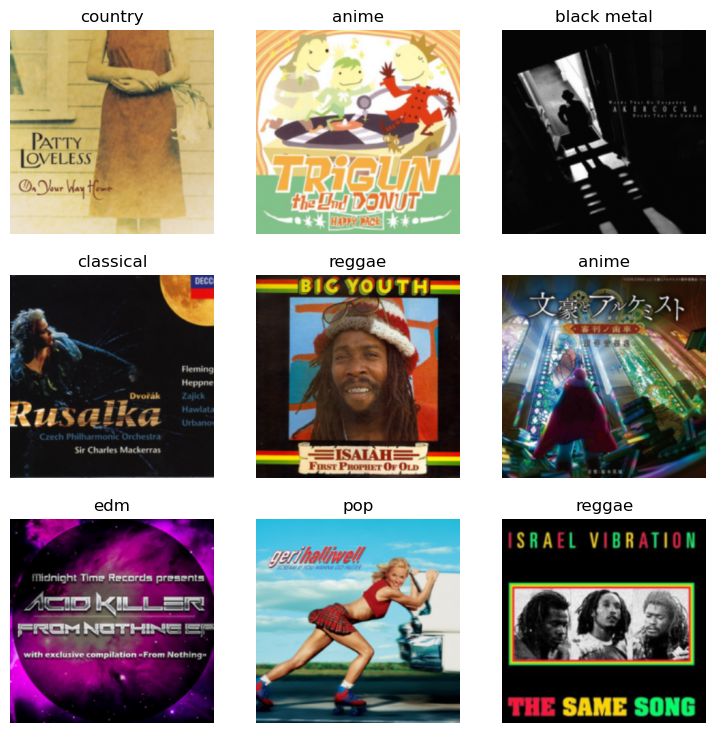

In [199]:
dls.valid.show_batch(max_n=9)

In [77]:
learn = cnn_learner(dls, models.resnet18, metrics=accuracy, pretrained=True)

In [203]:
learn.fine_tune(3)

epoch,train_loss,valid_loss,accuracy,time
0,2.248584,1.450609,0.557990,10:15


epoch,train_loss,valid_loss,accuracy,time
0,1.513570,1.231407,0.616624,13:42
1,1.165148,1.103172,0.650773,13:34
2,0.844611,1.075532,0.661082,13:28


In [204]:
# We save the progress, so we don't have to retrain the model from scratch if we want to go back a step.
learn.save('resnet18_fit_head')

Path('models/resnet18_fit_head.pth')

In [80]:
learn.load('resnet18_fit_head');

Train all layers

Now that we've tuned the head of the network to our dataset, the next step is to unfreeze all the layers, and see if we can generate a more accurate model. The procedure is the same as in the previous step:
1. Find the best learning rate.
2. Train the network with this learning rate.

In [81]:
# Train all layers

learn.unfreeze()

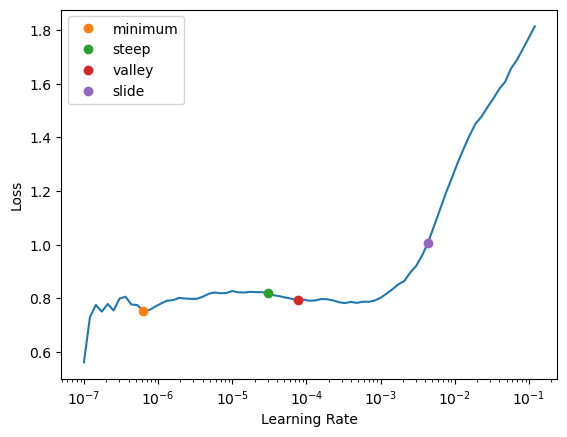

In [69]:
lrs = learn.lr_find(suggest_funcs=(minimum, steep, valley, slide))

In [208]:
# Train the head of the network

learn.fit_one_cycle(10, lrs.valley, cbs=EarlyStoppingCallback(monitor='accuracy', min_delta=0.1, patience=2))

epoch,train_loss,valid_loss,accuracy,time
0,0.737227,1.073846,0.662371,13:27
1,0.737102,1.069695,0.670747,13:30
2,0.693784,1.078170,0.672680,13:48


No improvement since epoch 0: early stopping


In [209]:
learn.save('resnet18_fit_all')

Path('models/resnet18_fit_all.pth')

In [287]:
learn.load('resnet18_fit_all');

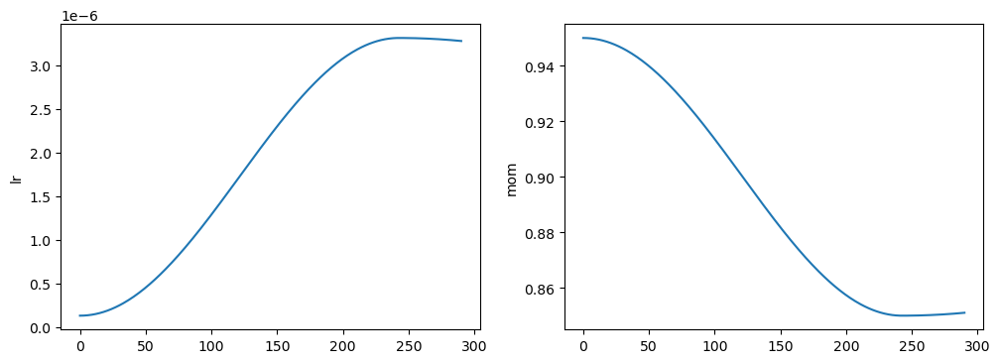

In [288]:
learn.recorder.plot_sched()

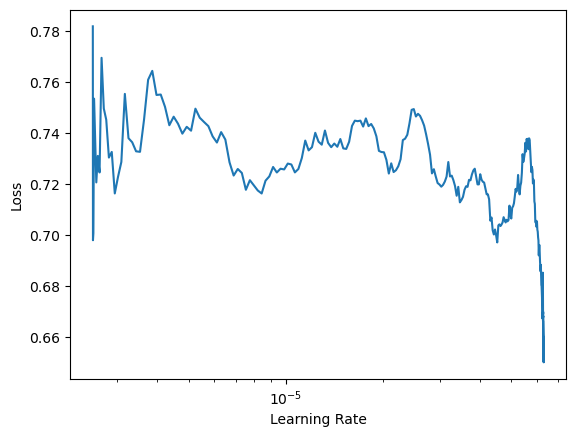

In [229]:
learn.recorder.plot_lr_find()

Text(0.5, 1.0, 'This is a custom title')

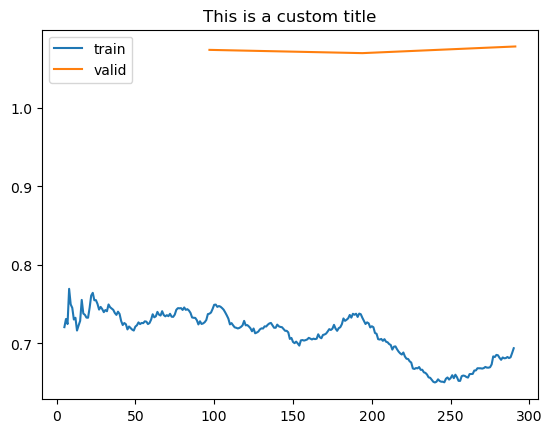

In [233]:
# example 1 (backwards compatible)
fig, ax = plt.subplots()
learn.recorder.plot_loss()
ax.set_title('This is a custom title') # further customization

In [295]:
interp = ClassificationInterpretation.from_learner(learn)

[]

In [293]:
interp.most_confused()

[('country', 'jazz', 59),
 ('country', 'pop', 30),
 ('country', 'rap', 30),
 ('pop', 'anime', 29),
 ('pop', 'edm', 26),
 ('country', 'anime', 22),
 ('classical', 'jazz', 19),
 ('disco', 'jazz', 16),
 ('jazz', 'pop', 16),
 ('reggae', 'jazz', 15),
 ('anime', 'edm', 14),
 ('disco', 'pop', 14),
 ('pop', 'rap', 14),
 ('country', 'reggae', 11),
 ('disco', 'edm', 11),
 ('reggae', 'edm', 9),
 ('jazz', 'edm', 8),
 ('reggae', 'rap', 8),
 ('country', 'edm', 7),
 ('edm', 'pop', 7),
 ('jazz', 'rap', 7),
 ('pop', 'jazz', 7),
 ('country', 'classical', 6),
 ('jazz', 'anime', 6),
 ('rap', 'jazz', 6),
 ('classical', 'edm', 5),
 ('country', 'disco', 5),
 ('disco', 'anime', 5),
 ('pop', 'country', 5),
 ('classical', 'pop', 4),
 ('disco', 'reggae', 4),
 ('edm', 'jazz', 4),
 ('jazz', 'reggae', 4),
 ('pop', 'reggae', 4),
 ('rap', 'edm', 4),
 ('anime', 'rap', 3),
 ('classical', 'anime', 3),
 ('classical', 'country', 3),
 ('disco', 'classical', 3),
 ('disco', 'country', 3),
 ('disco', 'rap', 3),
 ('rap', 'regg

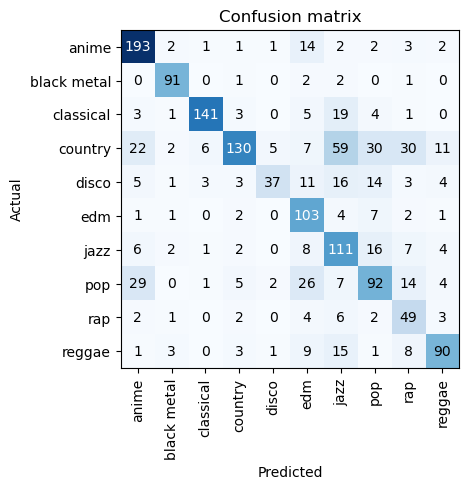

In [294]:
# interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

## fastai resnet 50 with unfreeze and earlystopping

In [106]:
dls = ImageDataLoaders.from_df(data, path='.', 
                               valid_pct=0.2, 
                               seed=RANDOM_STATE,
                               bs=16,
                               shuffle=True,
                               item_tfms=Resize(224, method=ResizeMethod.Pad),
                               batch_tfms = list(aug_transforms(size = 299, max_warp = 0, min_scale=0.9)))

In [107]:
learn = cnn_learner(dls, models.resnet50, metrics=accuracy, pretrained=True)

In [108]:
%%time
learn.fine_tune(3)

epoch,train_loss,valid_loss,accuracy,time
0,1.843235,1.314113,0.568943,27:19


epoch,train_loss,valid_loss,accuracy,time
0,1.375990,1.059005,0.648196,35:52


KeyboardInterrupt: 

In [58]:
dls = ImageDataLoaders.from_df(data, path='.', 
                               valid_pct=0.2, 
                               seed=RANDOM_STATE,
                               bs=16,
                               shuffle=True,
                               item_tfms=Resize(224, method=ResizeMethod.Pad),
                               batch_tfms = list(aug_transforms(size = 299, max_warp = 0)))

In [59]:
learn = cnn_learner(dls, models.resnet50, metrics=accuracy, pretrained=True)

In [60]:
%%time
learn.fine_tune(3)

epoch,train_loss,valid_loss,accuracy,time
0,1.880101,1.311474,0.579897,27:35


epoch,train_loss,valid_loss,accuracy,time
0,1.371957,1.053666,0.665593,35:29
1,0.988139,0.938208,0.703608,35:00
2,0.681984,0.912820,0.709407,34:52


CPU times: total: 17h 42min 46s
Wall time: 2h 12min 57s


In [61]:
# We save the progress, so we don't have to retrain the model from scratch if we want to go back a step.
learn.save('resnet50_fit_head_2')

Path('models/resnet50_fit_head_2.pth')

In [62]:
%%time
learn.fine_tune(7)

epoch,train_loss,valid_loss,accuracy,time
0,0.786219,1.087091,0.673969,27:03


epoch,train_loss,valid_loss,accuracy,time


KeyboardInterrupt: 

In [ ]:
%%time
learn.fine_tune(10, cbs=EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=2))

Train all layers

Now that we've tuned the head of the network to our dataset, the next step is to unfreeze all the layers, and see if we can generate a more accurate model. The procedure is the same as in the previous step:
1. Find the best learning rate.
2. Train the network with this learning rate.

In [45]:
# Train all layers

learn.unfreeze()

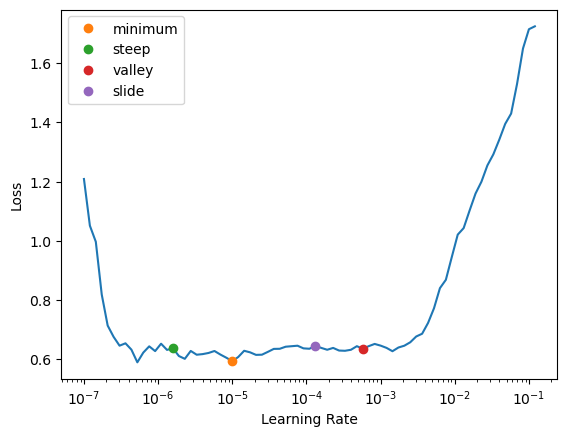

In [46]:
lrs = learn.lr_find(suggest_funcs=(minimum, steep, valley, slide))

In [47]:
# Train the head of the network

learn.fit_one_cycle(10, lrs.valley, cbs=EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=2))

epoch,train_loss,valid_loss,accuracy,time
0,0.677859,1.022004,0.679124,37:49


KeyboardInterrupt: 

In [ ]:
learn.save('resnet50_fit_all')

In [ ]:
learn.load('resnet50_fit_all');

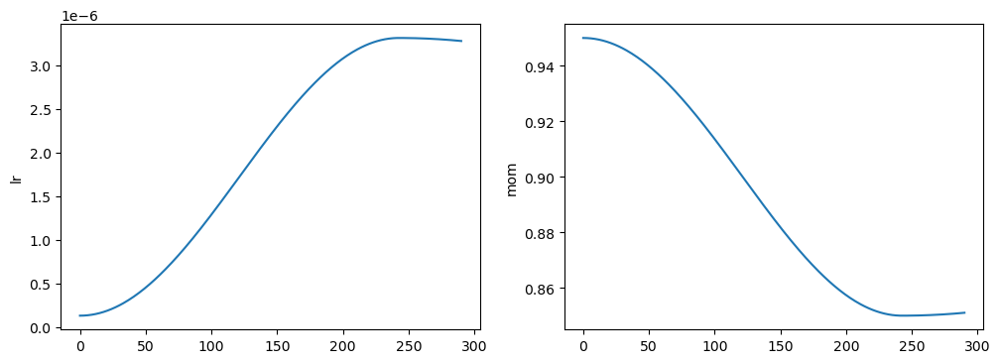

In [288]:
learn.recorder.plot_sched()

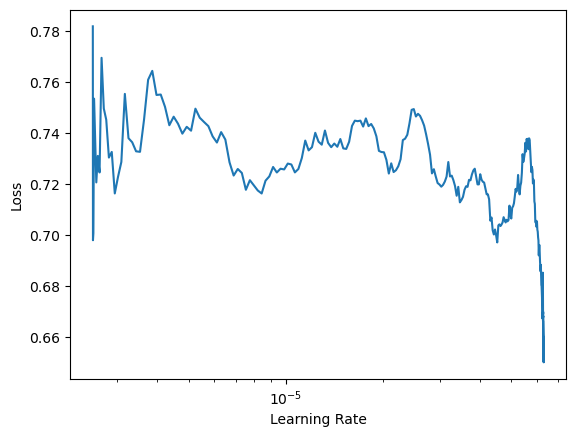

In [229]:
learn.recorder.plot_lr_find()

Text(0.5, 1.0, 'This is a custom title')

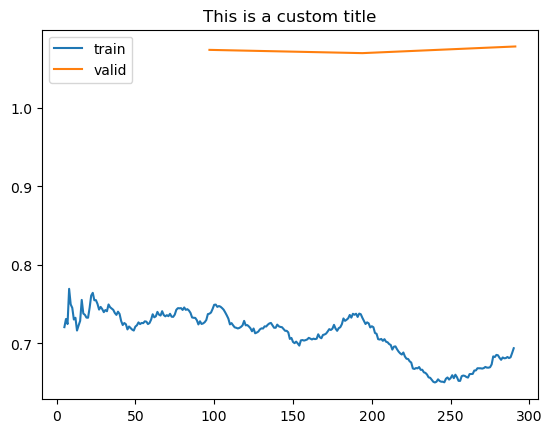

In [233]:
# example 1 (backwards compatible)
fig, ax = plt.subplots()
learn.recorder.plot_loss()
ax.set_title('This is a custom title') # further customization

In [295]:
interp = ClassificationInterpretation.from_learner(learn)

[]

In [293]:
interp.most_confused()

[('country', 'jazz', 59),
 ('country', 'pop', 30),
 ('country', 'rap', 30),
 ('pop', 'anime', 29),
 ('pop', 'edm', 26),
 ('country', 'anime', 22),
 ('classical', 'jazz', 19),
 ('disco', 'jazz', 16),
 ('jazz', 'pop', 16),
 ('reggae', 'jazz', 15),
 ('anime', 'edm', 14),
 ('disco', 'pop', 14),
 ('pop', 'rap', 14),
 ('country', 'reggae', 11),
 ('disco', 'edm', 11),
 ('reggae', 'edm', 9),
 ('jazz', 'edm', 8),
 ('reggae', 'rap', 8),
 ('country', 'edm', 7),
 ('edm', 'pop', 7),
 ('jazz', 'rap', 7),
 ('pop', 'jazz', 7),
 ('country', 'classical', 6),
 ('jazz', 'anime', 6),
 ('rap', 'jazz', 6),
 ('classical', 'edm', 5),
 ('country', 'disco', 5),
 ('disco', 'anime', 5),
 ('pop', 'country', 5),
 ('classical', 'pop', 4),
 ('disco', 'reggae', 4),
 ('edm', 'jazz', 4),
 ('jazz', 'reggae', 4),
 ('pop', 'reggae', 4),
 ('rap', 'edm', 4),
 ('anime', 'rap', 3),
 ('classical', 'anime', 3),
 ('classical', 'country', 3),
 ('disco', 'classical', 3),
 ('disco', 'country', 3),
 ('disco', 'rap', 3),
 ('rap', 'regg

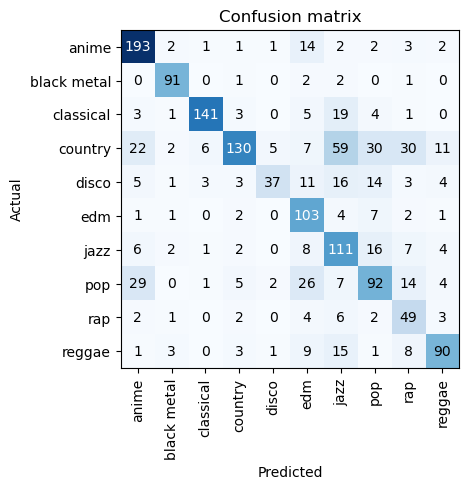

In [294]:
# interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [ ]:
plot_multi_top_losses(samples:int=3, figsize:Tuple[int, int]=(8, 8), save_misclassified:bool=False)

In [109]:
dls = ImageDataLoaders.from_df(data, path='.', 
                               valid_pct=0.2, 
                               seed=RANDOM_STATE,
                               bs=16,
                               shuffle=True,
                               item_tfms=Resize(224, method=ResizeMethod.Pad),
                               batch_tfms = list(aug_transforms(size = 299, max_warp = 0, min_scale=0.9)))#, min_scale=0.9

In [98]:
learn = cnn_learner(dls, models.resnet50, metrics=accuracy, pretrained=True)

In [43]:
%%time
learn.fine_tune(3)

epoch,train_loss,valid_loss,accuracy,time
0,1.862980,1.337299,0.579253,28:35


epoch,train_loss,valid_loss,accuracy,time
0,1.327624,1.003485,0.678479,11:03:31
1,0.952011,0.898388,0.705541,36:00
2,0.630063,0.871120,0.710052,37:59


CPU times: total: 18h 51min 59s
Wall time: 12h 46min 6s


In [44]:
# We save the progress, so we don't have to retrain the model from scratch if we want to go back a step.
learn.save('resnet50_fit_head')

Path('models/resnet50_fit_head.pth')

In [110]:
learn.load('resnet50_fit_head');

In [111]:
# Train all layers

learn.unfreeze()

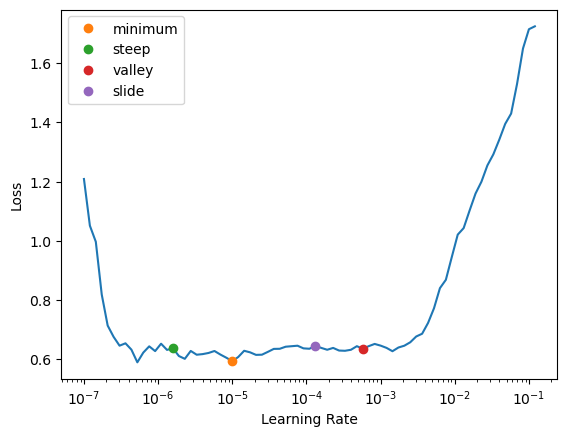

In [46]:
# lrs = learn.lr_find(suggest_funcs=(minimum, steep, valley, slide))

In [112]:
# Train the head of the network

learn.fit_one_cycle(10,  cbs=EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=2))

epoch,train_loss,valid_loss,accuracy,time
0,1.013496,1.338772,0.588918,35:37
1,1.722977,1.643357,0.464562,36:08


KeyboardInterrupt: 

In [ ]:
learn.save('resnet50_fit_all')

In [ ]:
learn.load('resnet50_fit_all');

In [ ]:
model = simple_cnn((3,16,16,2))
learn = Learner(data, model, metrics=[accuracy])
learn.fit_one_cycle(5,1e-4, callbacks=[SaveModelCallback(learn, every='epoch', monitor='accuracy', name='model')])

In [ ]:
learn.fit_one_cycle(10,  cbs=EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=2))

In [128]:
genres = ['anime',
          'black metal',
          'classical',
          'country',
          'disco',
          'edm',
          'jazz',
          'pop',
          'rap',
          'reggae']
path = "./"

data = create_data_frame(genres)

data = data.query('image not in @dupl_list')

dls = ImageDataLoaders.from_df(data, path='.', 
                               valid_pct=0.2, 
                               seed=RANDOM_STATE,
                               bs=64,
                               shuffle=True,
                               item_tfms=Resize(224, method=ResizeMethod.Pad),
                               batch_tfms = list(aug_transforms(size = 299, max_warp = 0, min_scale=0.9)))




In [129]:
learn = cnn_learner(dls, models.resnet50, metrics=accuracy, pretrained=True)
learn.fine_tune(10, cbs=[SaveModelCallback(every_epoch=True), 
                        EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=2)])

epoch,train_loss,valid_loss,accuracy,time
0,1.977504,1.344733,0.599227,29:34


epoch,train_loss,valid_loss,accuracy,time
0,1.225207,1.113003,0.643041,37:59
1,0.997428,1.049270,0.666881,37:56
2,0.808384,1.068634,0.673325,37:54
3,0.600205,1.038341,0.704253,37:37
4,0.421014,1.096021,0.702320,37:28
5,0.297953,1.126936,0.702964,37:35


No improvement since epoch 3: early stopping


In [130]:
learn.save('resnet50_fit_all_final')

Path('models/resnet50_fit_all_final.pth')

In [ ]:
learn.load('resnet50_fit_all_final');

In [131]:
learn.unfreeze()

In [132]:
learn.fine_tune(10, cbs=[SaveModelCallback(every_epoch=True), 
                        EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=2)])

epoch,train_loss,valid_loss,accuracy,time
0,0.235369,1.326296,0.691366,27:47


epoch,train_loss,valid_loss,accuracy,time
0,0.205158,1.196941,0.699098,37:17
1,0.183969,1.236537,0.710696,37:40
2,0.192821,1.426423,0.699742,38:13
3,0.187300,1.355573,0.692655,38:47


No improvement since epoch 1: early stopping


In [133]:
learn.save('resnet50_fit_all_final_unfreeze')

Path('models/resnet50_fit_all_final_unfreeze.pth')

## кластеризация


In [138]:
from sklearn.cluster import KMeans
import numpy as np
X = np.array([[1, 2], [1, 4], [1, 0],
              [10, 2], [10, 4], [10, 0]])
display(X)
kmeans = KMeans(n_clusters=2, random_state=0, n_init="auto").fit(X)
print(kmeans.labels_)
kmeans.predict([[0, 0], [12, 3]])
print(kmeans.cluster_centers_)

array([[ 1,  2],
       [ 1,  4],
       [ 1,  0],
       [10,  2],
       [10,  4],
       [10,  0]])

[1 1 1 0 0 0]
[[10.  2.]
 [ 1.  2.]]


In [139]:
kmeans = KMeans(n_clusters=10, random_state=0, n_init="auto").fit(df_img.drop('target', axis=1))

In [141]:
kmeans.labels_

array([4, 5, 3, ..., 6, 0, 0])

In [144]:
kmeans.cluster_centers_

array([[0.0437548 , 0.03019679, 0.06790049, ..., 0.0785864 , 0.03387815,
        0.07577565],
       [0.05003192, 0.02372643, 0.09518856, ..., 0.05503055, 0.00986083,
        0.05580672],
       [0.03364177, 0.03679614, 0.07158536, ..., 0.05172786, 0.00770382,
        0.05145087],
       ...,
       [0.09387863, 0.06971544, 0.12018116, ..., 0.05509111, 0.03127329,
        0.07833955],
       [0.03240765, 0.09027781, 0.09527005, ..., 0.0326498 , 0.00548977,
        0.02828033],
       [0.09924433, 0.06598035, 0.12883228, ..., 0.04113246, 0.02661006,
        0.18648824]], dtype=float32)

In [508]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

In [518]:
clusterer = KMeans(n_clusters=5, random_state=10)
cluster_labels = clusterer.fit_predict(df_img.drop('target', axis=1))

In [520]:
silhouette_avg = silhouette_score(df_img.drop('target', axis=1), cluster_labels)
print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

For n_clusters = 6 The average silhouette_score is : 0.02473862003592199


In [521]:
sample_silhouette_values = silhouette_samples(df_img.drop('target', axis=1), cluster_labels)

In [577]:
X = df_img.drop('target', axis=1).values
y = df_img['target'].values

In [544]:
X[:, 0]

array([0.20601438, 0.00396658, 0.0513238 , ..., 0.        , 0.15590411,
       0.03034025])

In [545]:
X[:, 1]

array([1.3719034e-02, 0.0000000e+00, 0.0000000e+00, ..., 2.1599531e-04,
       9.6659940e-01, 0.0000000e+00])

### umap Traditional clustering

In [567]:
kmeans_labels = KMeans(n_clusters=3).fit_predict(X)

In [572]:
# standard_embedding = umap.UMAP(random_state=42).fit_transform(X)
standard_embedding = umap.UMAP(random_state=42, n_components=20, n_neighbors=15).fit_transform(X)

In [573]:
standard_embedding.shape

(7760, 20)

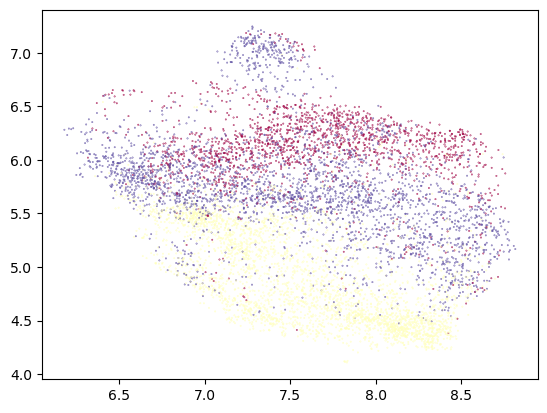

In [574]:
plt.scatter(standard_embedding[:, 0], standard_embedding[:, 1], c=kmeans_labels, s=0.1, cmap='Spectral');


In [581]:
clusterable_embedding = umap.UMAP(
    n_neighbors=30,
    min_dist=0.0,
    n_components=2,
    random_state=42,
).fit_transform(X)

In [582]:
enc = OrdinalEncoder()
target_enc = enc.fit_transform(df_img['target'].to_frame())
y = target_enc

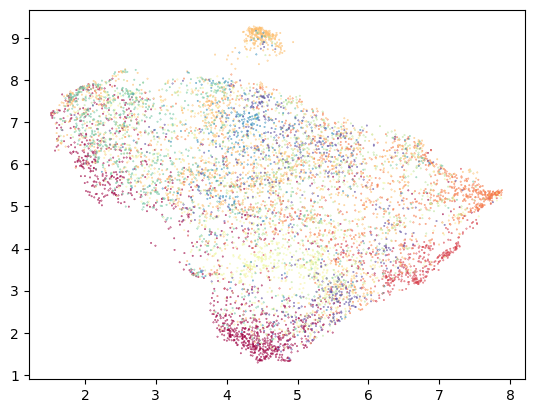

In [583]:
plt.scatter(clusterable_embedding[:, 0], clusterable_embedding[:, 1],
            c=y, s=0.1, cmap='Spectral');

In [584]:
from sklearn.cluster import HDBSCAN

In [586]:
labels = HDBSCAN(
    min_samples=10,
    min_cluster_size=500,
).fit_predict(clusterable_embedding)

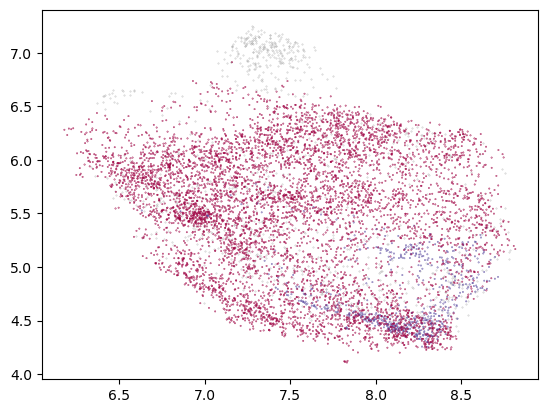

In [587]:
clustered = (labels >= 0)
plt.scatter(standard_embedding[~clustered, 0],
            standard_embedding[~clustered, 1],
            color=(0.5, 0.5, 0.5),
            s=0.1,
            alpha=0.5)
plt.scatter(standard_embedding[clustered, 0],
            standard_embedding[clustered, 1],
            c=labels[clustered],
            s=0.1,
            cmap='Spectral');

In [ ]:
manifold = umap.UMAP(n_components=20, n_neighbors=15).fit(X, y)
X_reduced = manifold.transform(X)
X_reduced.shape

plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=y, s=0.5);
# umap.plot.points(manifold, labels=df_img['target'].to_numpy(), theme="fire");

For n_clusters = 3 The average silhouette_score is : 0.03177488737331684


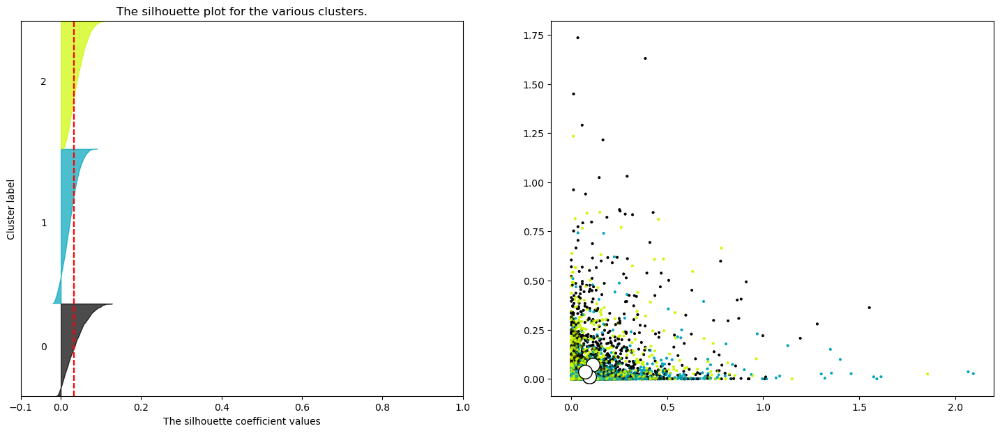

In [548]:
a = 2
b = 3
n_clusters = 3
# Создайте подзаголовок с 1 строкой и 2 столбцами
fig, (ax1, ax2) = plt.subplots(1, 2)
fig.set_size_inches(18, 7)
# Первый подсюжет — это график силуэта
# Коэффициент силуэта может варьироваться от -1 до 1, но в этом примере в
# лежат в пределах [-0.1, 1]
ax1.set_xlim([-0.1, 1])
# (n_clusters+1)*10 предназначен для вставки пустого пространства между с
# графики отдельных кластеров, чтобы четко их разграничить.
ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])
# Инициализируем кластеризатор значением n_clusters и генератором случайн
# начальное число из 10 для воспроизводимости.
clusterer = KMeans(n_clusters=n_clusters, random_state=10)
cluster_labels = clusterer.fit_predict(X)
# Silhouette_score дает среднее значение для всех образцов.
# Это дает представление о плотности и разделении образовавшихся
# clusters
silhouette_avg = silhouette_score(X, cluster_labels)
print(
    "For n_clusters =",
    n_clusters,
    "The average silhouette_score is :",
    silhouette_avg,
)
# Вычисляем оценки силуэта для каждого образца
sample_silhouette_values = silhouette_samples(X, cluster_labels)

y_lower = 10
for i in range(n_clusters):
    # Объединить оценки силуэтов для образцов, принадлежащих
    # кластер i и отсортируйте их
    ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i
    color = cm.nipy_spectral(float(i) / n_clusters)
    ax1.fill_betweenx(
        np.arange(y_lower, y_upper),
        0,
        ith_cluster_silhouette_values,
        facecolor=color,
        edgecolor=color,
        alpha=0.7,
    )
    # Пометьте графики силуэтов номерами их кластеров посередине.
    ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    # Вычисляем новый y_lower для следующего графика
    y_lower = y_upper + 10  # 10 для 0 образцов
    
    
    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")
    # Вертикальная линия для средней оценки силуэта всех значений.
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
    ax1.set_yticks([])  # Очистите метки/галочки Yaxis
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
    # 2-й график, показывающий фактически сформированные кластеры
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        X[:, a], X[:, b], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )
    # Маркировка кластеров
    centers = clusterer.cluster_centers_
    # Нарисуйте белые круги в центрах кластеров
    ax2.scatter(
        centers[:, a],
        centers[:, b],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

In [559]:
X.shape[1]

2048

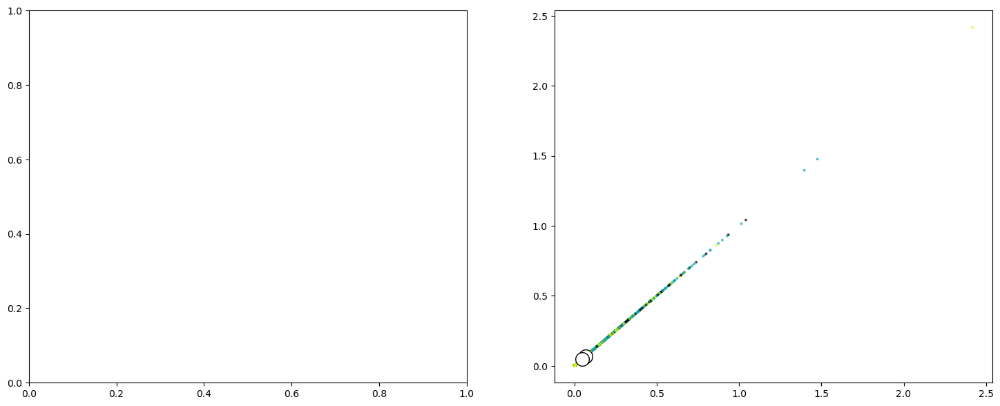

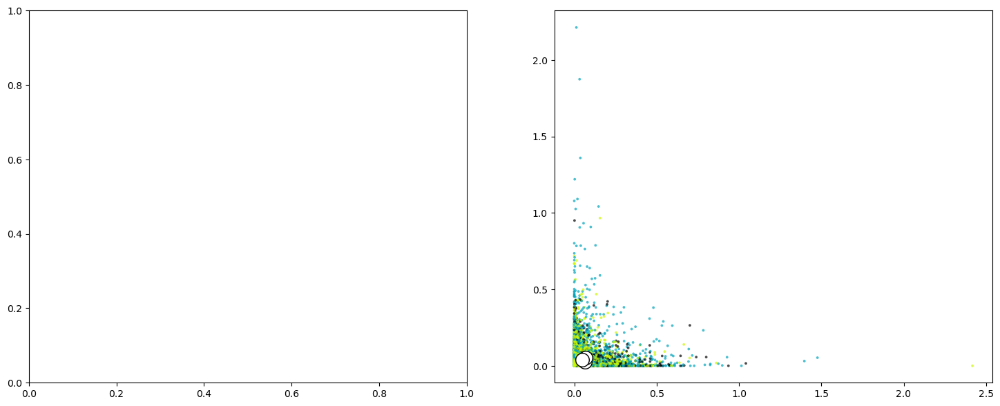

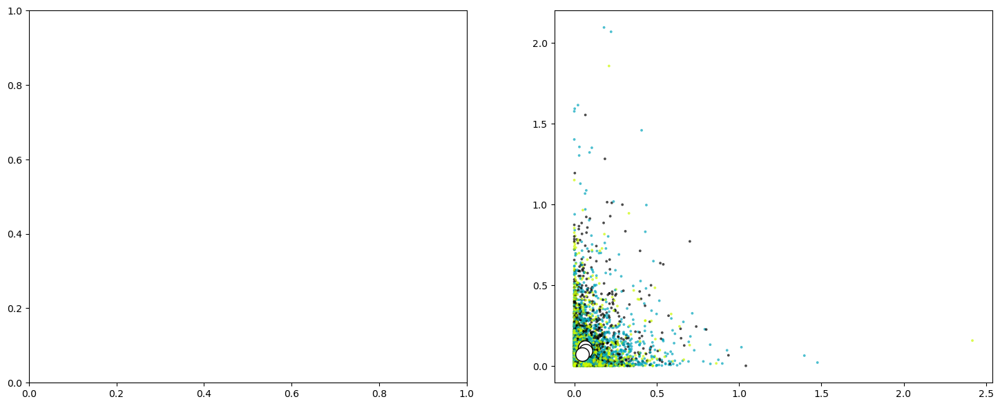

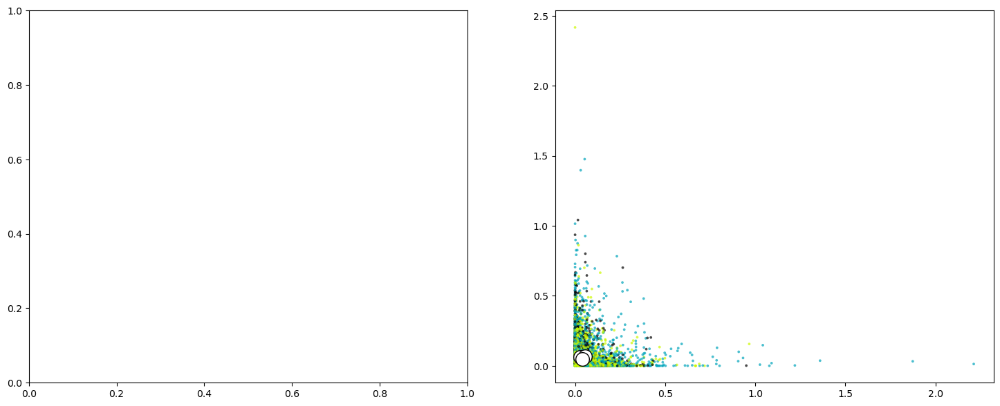

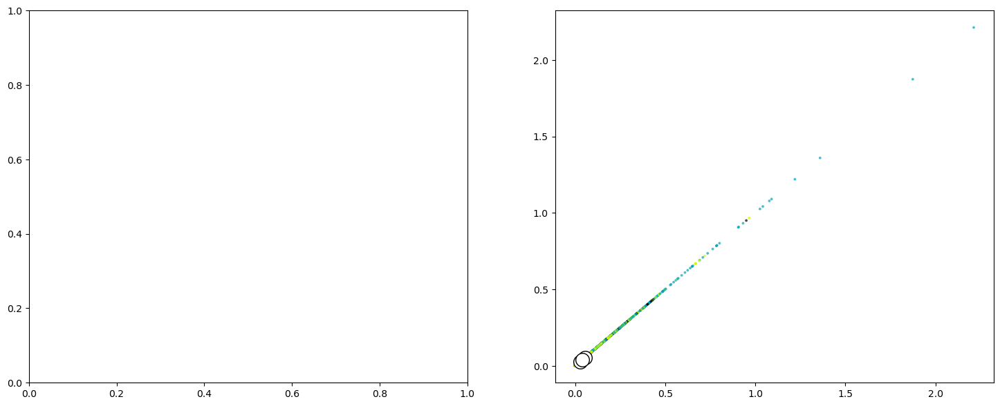

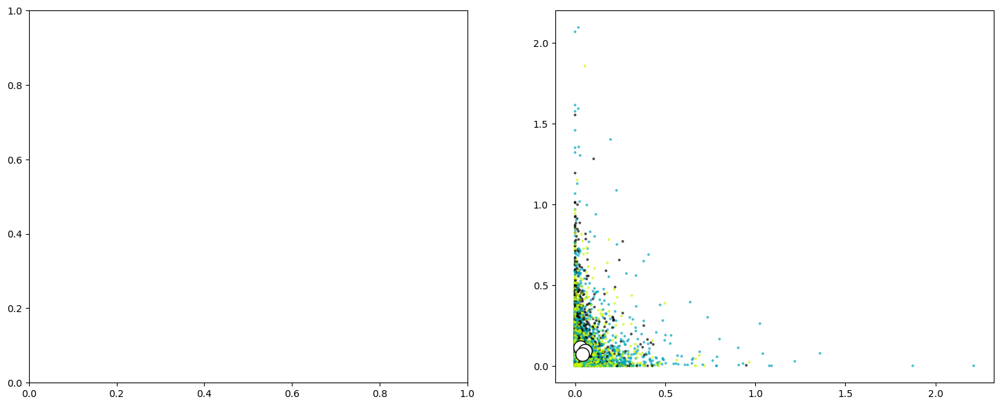

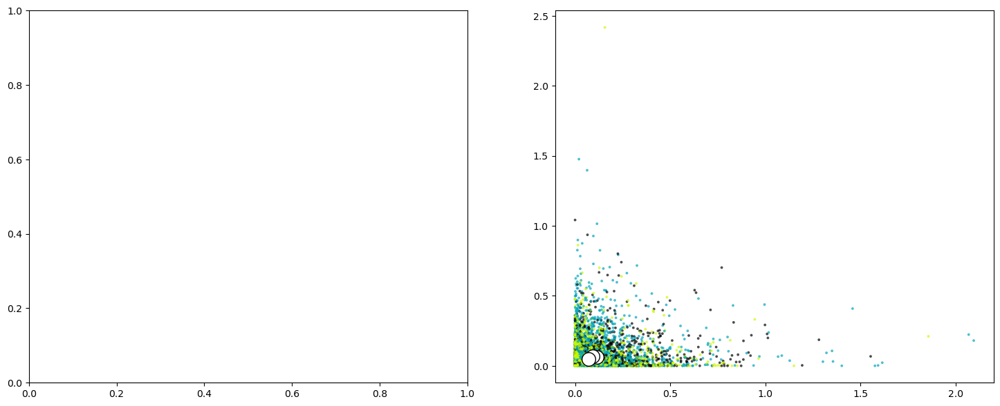

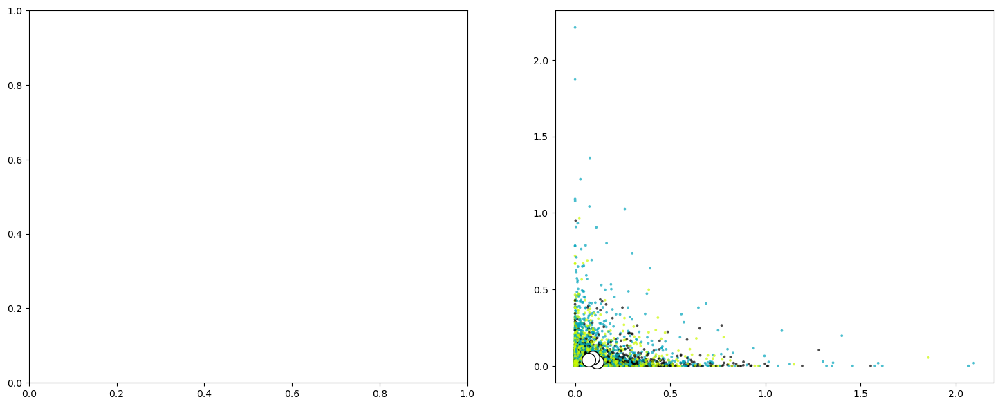

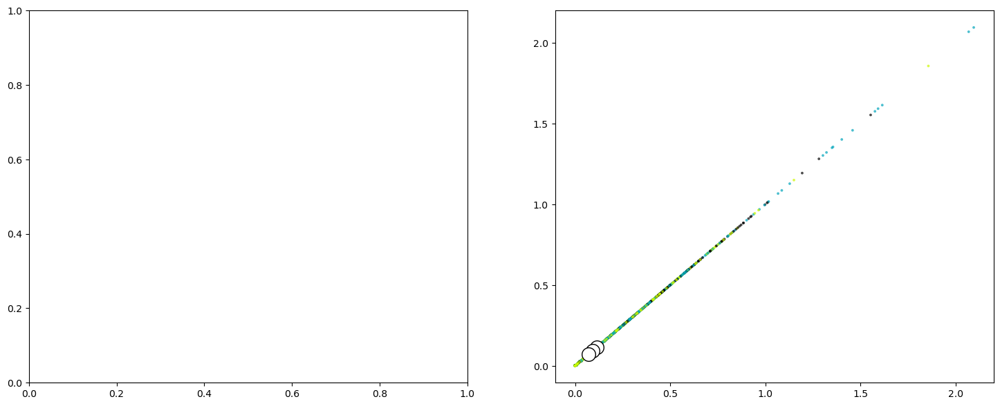

In [562]:

for a in range(0, 3):
    for b in range(0, 3):
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)
        # 2-й график, показывающий фактически сформированные кластеры
        colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(
            X[:, a], X[:, b], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
        )
        # Маркировка кластеров
        centers = clusterer.cluster_centers_
        # Нарисуйте белые круги в центрах кластеров
        ax2.scatter(
            centers[:, a],
            centers[:, b],
            marker="o",
            c="white",
            alpha=1,
            s=200,
            edgecolor="k",
        )

In [535]:
# Генерация образца данных из make_blobs
# Этот конкретный параметр имеет один отдельный кластер и три кластера, расположенных рядом
# together.
X, y = make_blobs(
    n_samples=500,
    n_features=2,
    centers=4,
    cluster_std=1,
    center_box=(-10.0, 10.0),
    shuffle=True,
    random_state=1,
)  # Для воспроизводимости
print(X)
print(y)

[[-6.92324165e+00 -1.06695320e+01]
 [-8.63062033e+00 -7.13940564e+00]
 [-9.63048069e+00 -2.72044935e+00]
 [-2.30647659e+00  5.30797676e+00]
 [-7.57005366e+00 -3.01446491e+00]
 [-1.00051011e+00  2.77905153e+00]
 [-4.81826839e+00 -2.77214822e+00]
 [-5.33964799e+00 -1.27625764e+00]
 [-7.94308840e+00 -3.89993901e+00]
 [-5.54924525e+00 -3.41298968e+00]
 [-5.14508990e+00 -9.54492198e+00]
 [-7.09669936e+00 -8.04074036e+00]
 [-5.82641512e+00 -1.96346196e+00]
 [-1.83198811e+00  3.52863145e+00]
 [-7.34267235e+00 -3.16546482e+00]
 [-7.34072825e+00 -6.92427252e+00]
 [-7.94653906e+00 -3.36768655e+00]
 [-8.24598536e+00 -8.61315821e+00]
 [-1.98197711e+00  4.02243551e+00]
 [-4.35098035e+00 -3.69476678e+00]
 [-1.04768696e+01 -3.60318139e+00]
 [-1.10195984e+01 -3.15882031e+00]
 [-5.17255904e+00 -4.31835971e+00]
 [-2.40671820e+00  6.09894447e+00]
 [-6.72149498e+00 -2.88440806e+00]
 [-6.58935963e+00 -4.43379548e+00]
 [-1.46126019e+00  4.52549851e+00]
 [-9.19003455e-01  3.45278927e+00]
 [-1.04093517e+01 -2

In [537]:
X[:, 0]

array([-6.92324165e+00, -8.63062033e+00, -9.63048069e+00, -2.30647659e+00,
       -7.57005366e+00, -1.00051011e+00, -4.81826839e+00, -5.33964799e+00,
       -7.94308840e+00, -5.54924525e+00, -5.14508990e+00, -7.09669936e+00,
       -5.82641512e+00, -1.83198811e+00, -7.34267235e+00, -7.34072825e+00,
       -7.94653906e+00, -8.24598536e+00, -1.98197711e+00, -4.35098035e+00,
       -1.04768696e+01, -1.10195984e+01, -5.17255904e+00, -2.40671820e+00,
       -6.72149498e+00, -6.58935963e+00, -1.46126019e+00, -9.19003455e-01,
       -1.04093517e+01, -6.36722809e+00, -6.72766125e+00, -2.27956075e+00,
       -5.84887560e+00, -6.07993051e+00, -5.26682929e+00, -6.05367512e+00,
       -1.00822205e+01, -1.18708735e+01, -5.37107307e+00, -9.37590900e+00,
       -6.63401987e+00, -9.54609655e+00, -1.69825542e+00, -5.60217602e+00,
       -6.03429022e+00, -6.37230784e+00, -1.02264783e+01, -5.95678148e+00,
       -1.42706535e+00, -6.20735304e-01, -3.28102793e-01, -1.06230545e+01,
       -9.12674270e+00, -

In [538]:
X[:, 1]

array([-10.66953197,  -7.13940564,  -2.72044935,   5.30797676,
        -3.01446491,   2.77905153,  -2.77214822,  -1.27625764,
        -3.89993901,  -3.41298968,  -9.54492198,  -8.04074036,
        -1.96346196,   3.52863145,  -3.16546482,  -6.92427252,
        -3.36768655,  -8.61315821,   4.02243551,  -3.69476678,
        -3.60318139,  -3.15882031,  -4.31835971,   6.09894447,
        -2.88440806,  -4.43379548,   4.52549851,   3.45278927,
        -2.67482046,  -3.32666072,  -7.14516267,   5.1045219 ,
        -3.03970506,  -7.08197568,  -2.69645055,  -9.62979077,
        -4.25071043,  -3.03273343,  -7.95635833,  -4.55315308,
        -2.58340356,  -2.84917422,   2.79071751,  -0.65990849,
        -4.08821196,  -8.63190046,  -2.33998717,  -3.97905701,
         5.08904128,   6.59346952,   4.11918201,  -4.54719161,
        -4.46180568,  -3.23505873,  -7.10400981,  -4.12880752,
        -4.95351774,  -6.06751247,  -4.67574045,  -2.73350095,
         4.20765201,   5.92630669,  -3.64808151,  -4.26

For n_clusters = 2 The average silhouette_score is : 0.038785481282098064
For n_clusters = 3 The average silhouette_score is : 0.03177488737331684
For n_clusters = 4 The average silhouette_score is : 0.02821591182770252
For n_clusters = 5 The average silhouette_score is : 0.02473862003592199
For n_clusters = 6 The average silhouette_score is : 0.02475309970755603


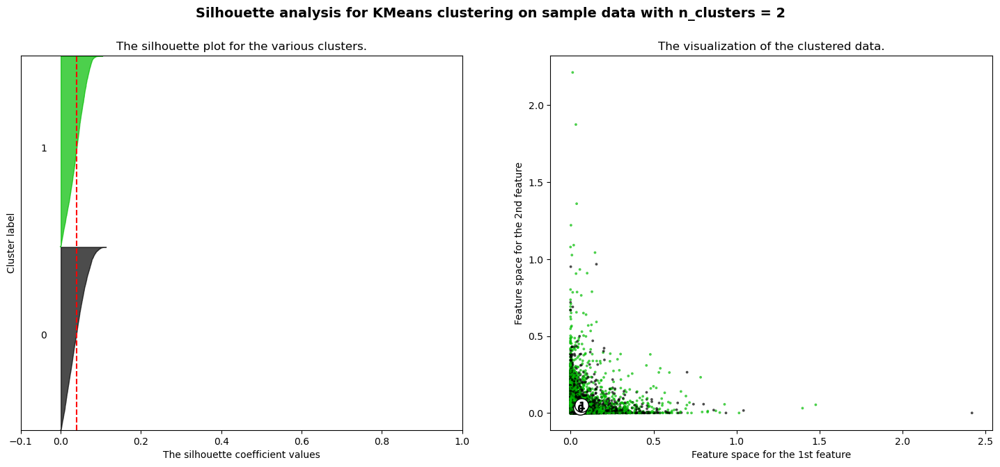

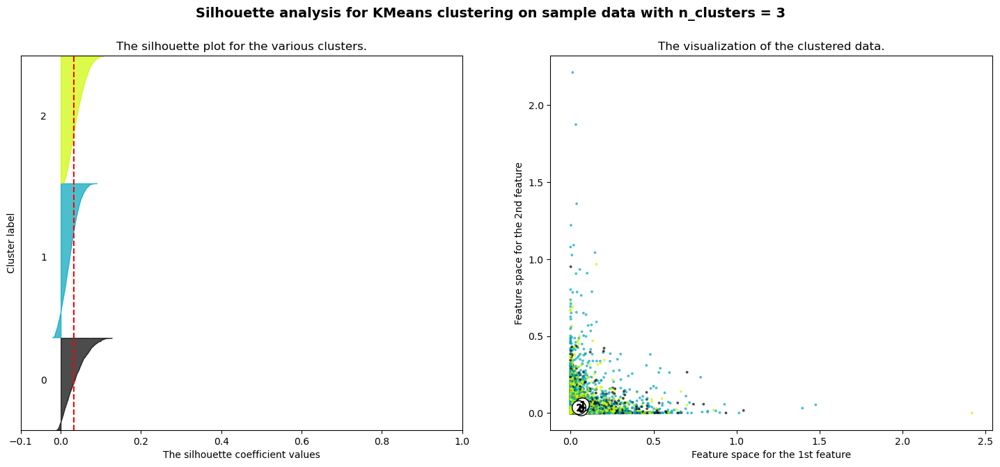

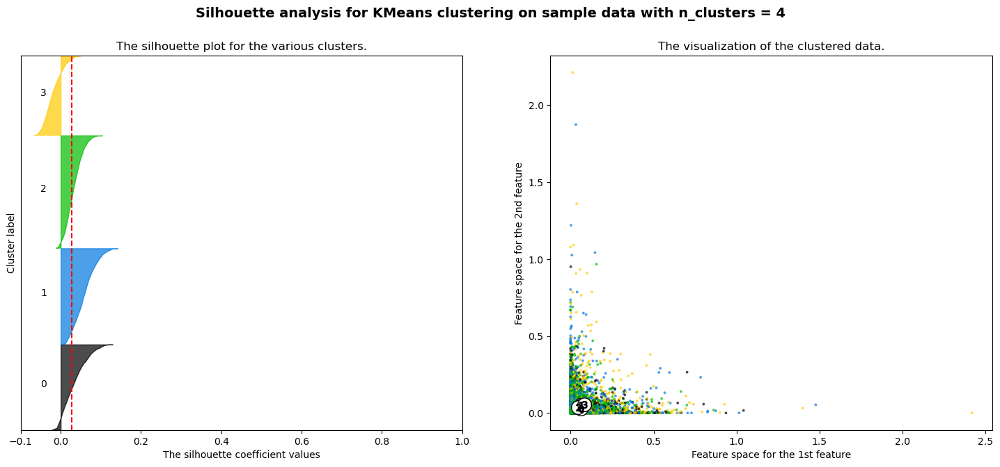

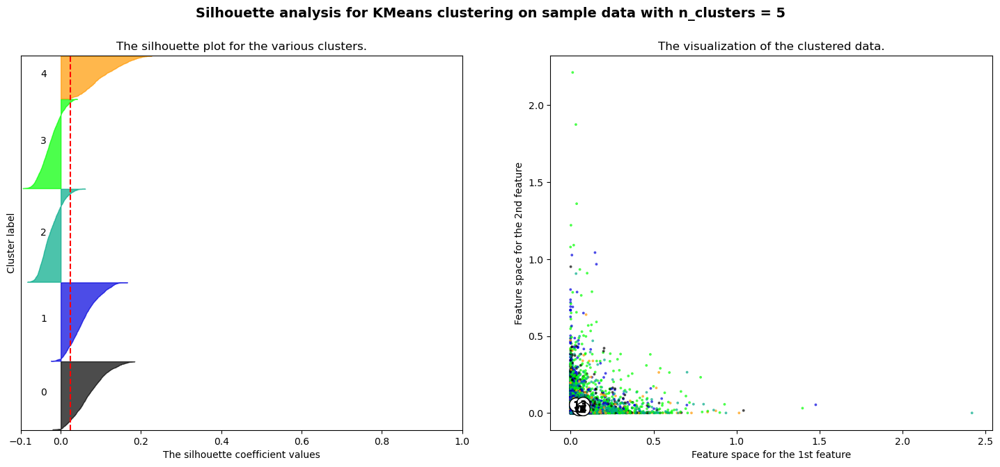

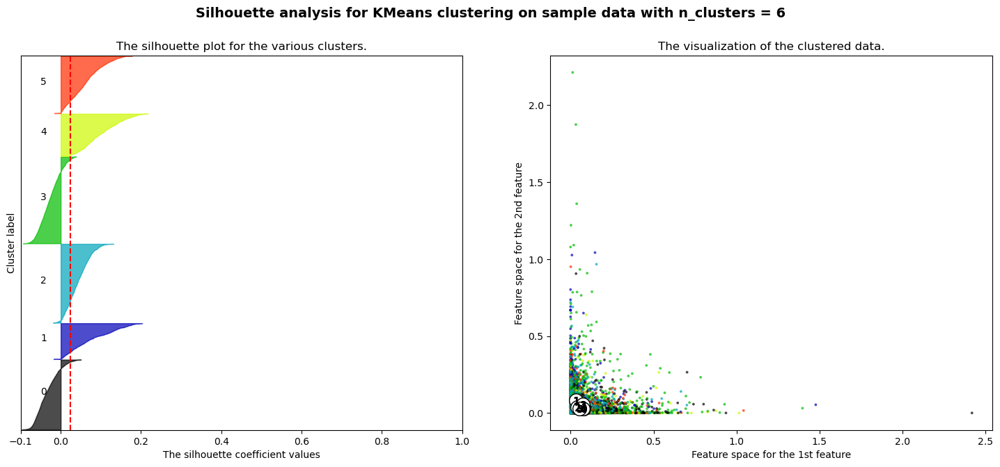

In [547]:
range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Создайте подзаголовок с 1 строкой и 2 столбцами
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # Первый подсюжет — это график силуэта
    # Коэффициент силуэта может варьироваться от -1 до 1, но в этом примере все
    # лежат в пределах [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # (n_clusters+1)*10 предназначен для вставки пустого пространства между силуэтами
    # графики отдельных кластеров, чтобы четко их разграничить.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Инициализируем кластеризатор значением n_clusters и генератором случайных чисел
    # начальное число из 10 для воспроизводимости.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # Silhouette_score дает среднее значение для всех образцов.
    # Это дает представление о плотности и разделении образовавшихся
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Вычисляем оценки силуэта для каждого образца
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Объединить оценки силуэтов для образцов, принадлежащих
        # кластер i и отсортируйте их
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Пометьте графики силуэтов номерами их кластеров посередине.
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Вычисляем новый y_lower для следующего графика
        y_lower = y_upper + 10  # 10 для 0 образцов

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # Вертикальная линия для средней оценки силуэта всех значений.
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Очистите метки/галочки Yaxis
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2-й график, показывающий фактически сформированные кластеры
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        X[:, 0], X[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Маркировка кластеров
    centers = clusterer.cluster_centers_
    # Нарисуйте белые круги в центрах кластеров
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()


For n_clusters = 2 The average silhouette_score is : 0.7049787496083262
For n_clusters = 3 The average silhouette_score is : 0.5882004012129721
For n_clusters = 4 The average silhouette_score is : 0.6505186632729437
For n_clusters = 5 The average silhouette_score is : 0.561464362648773
For n_clusters = 6 The average silhouette_score is : 0.4857596147013469


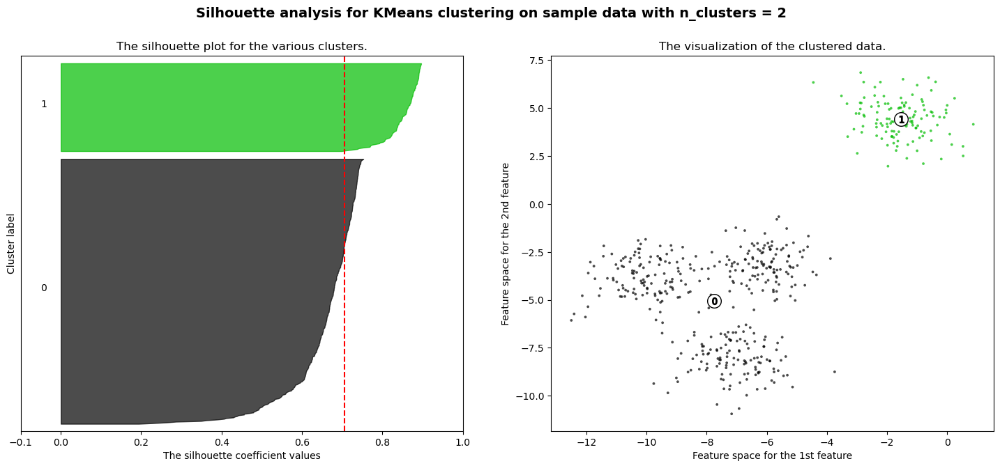

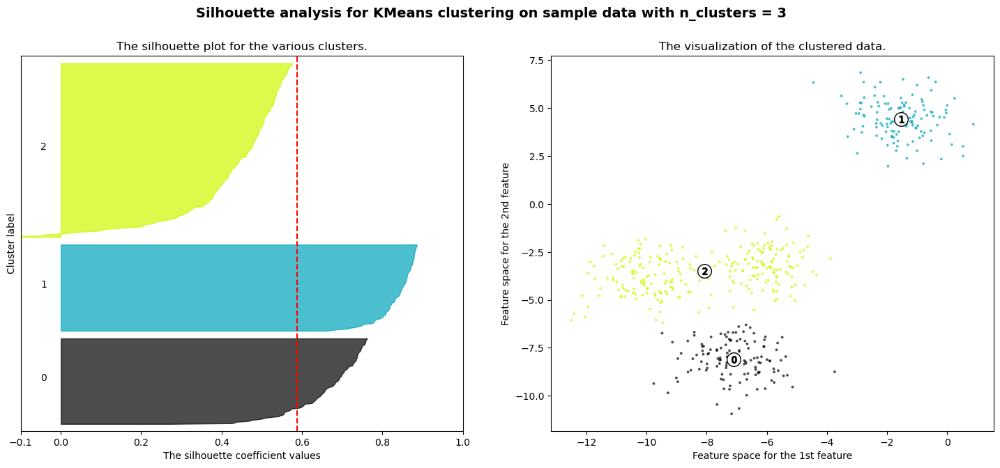

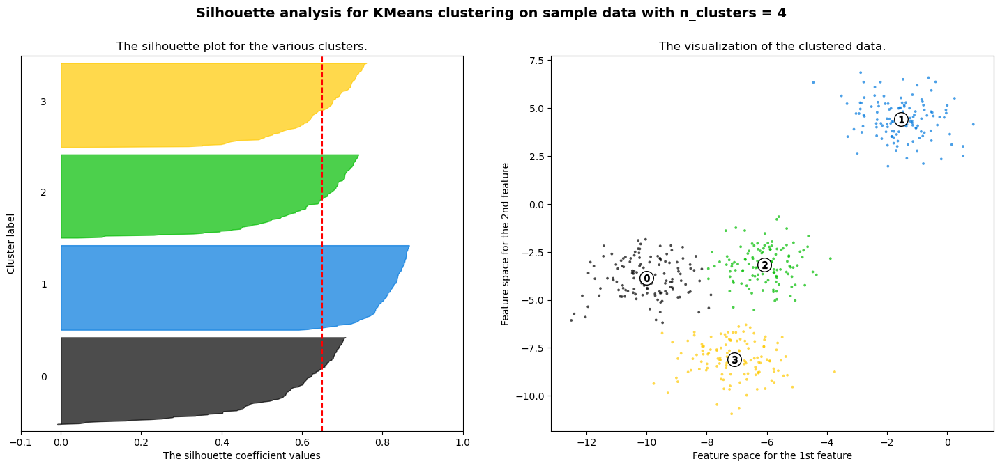

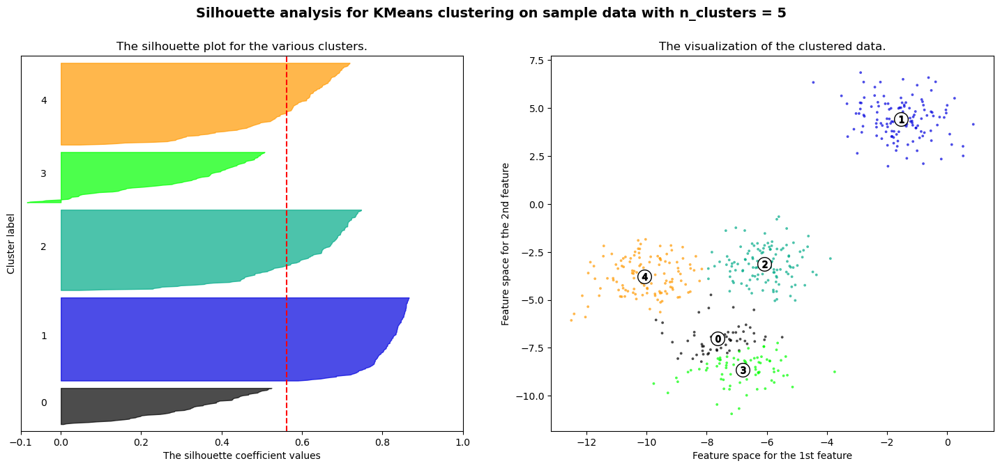

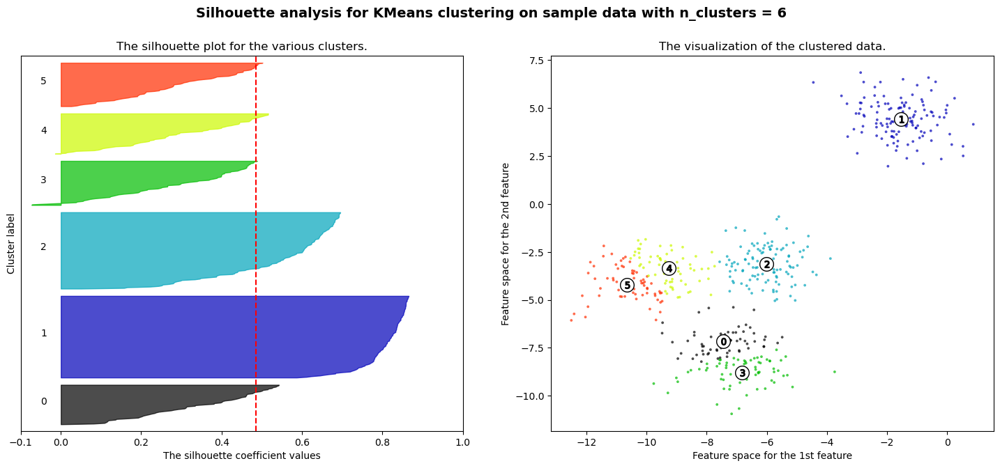

In [511]:
range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Создайте подзаголовок с 1 строкой и 2 столбцами
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # Первый подсюжет — это график силуэта
    # Коэффициент силуэта может варьироваться от -1 до 1, но в этом примере все
    # лежат в пределах [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # (n_clusters+1)*10 предназначен для вставки пустого пространства между силуэтами
    # графики отдельных кластеров, чтобы четко их разграничить.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Инициализируем кластеризатор значением n_clusters и генератором случайных чисел
    # начальное число из 10 для воспроизводимости.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # Silhouette_score дает среднее значение для всех образцов.
    # Это дает представление о плотности и разделении образовавшихся
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Вычисляем оценки силуэта для каждого образца
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Объединить оценки силуэтов для образцов, принадлежащих
        # кластер i и отсортируйте их
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Пометьте графики силуэтов номерами их кластеров посередине.
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Вычисляем новый y_lower для следующего графика
        y_lower = y_upper + 10  # 10 для 0 образцов

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # Вертикальная линия для средней оценки силуэта всех значений.
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Очистите метки/галочки Yaxis
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2-й график, показывающий фактически сформированные кластеры
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        X[:, 0], X[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Маркировка кластеров
    centers = clusterer.cluster_centers_
    # Нарисуйте белые круги в центрах кластеров
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()


## **Выводы**

**Описание данных**

В нашем основном датасете около 5800 строк. Пропусков в данных нет. В признаке "query_id" содержится идентификатор описания в формате <имя файла изображения>#<порядковый номер описания>. Заявлено, что к каждой картинке может быть до 5 описаний. Но все записи в датасете содержат только порядковый номер 2. Вероятнее всего в датасете представлена только часть данных. А вот в test_queries содержаться запросы с разными номерами. Поэтому мы не удалили номер запроса.

Обучающая выборка содержит 977 уникальных описаний и 1000 уникальных изображений.

В CrowdAnnotations содержится 47830 строк. Пропусков также нет. Столбец pos_share содержит информацию о доле людей, которые отметили пару картинка-описание как подходящие друг другу. Но стоит отметить, что в отличие от экспертов, обычные люди могли ставить только 1 или 0. Тогда как эксперты могли выставлять оценку соответствия по шкале от 1 до 4. Можно сказать, что разметка данных от экспертов более качественная. Возможно стоит использовать именно её для лучшего обучения модели. Также при объединении датафреймов CrowdAnnotations и ExpertAnnotations теряется очень много данных, в том числе с экспертной оценкой.

Выборка содердит разные по формату и тематике изображения людей и животных.

**Объединение датафреймов**

Для решения задачи нам необходимо было выделить целевой признак. В нешем случае это степень соответствия описания и изображения. У нас есть две талицы с такой информацией: `CrowdAnnotations` и `ExpertAnnotations`.

В `CrowdAnnotations` содержится 47830 строк. Пропусков нет. Столбец pos_share содержит информацию о доле людей, которые отметили пару картинка-описание как подходящие друг другу. Но стоит отметить, что в отличие от экспертов, обычные люди могли ставить только 1 или 0. Тогда как эксперты в `ExpertAnnotations` могли выставлять оценку соответствия по шкале от 1 до 4. Можно сказать, что разметка данных от экспертов более качественная. 

Кажется, что в `CrowdAnnotations` много данных, однако при объединении с train_dataset мы теряем порядка 60% строк. Так как в `CrowdAnnotations` нет многих сочетаний картинка - описание из `train_dataset`, в котором содержится текст запроса. А соединение с сохранением всех строк `train_dataset` не имеет смысла, так как мы не получаем целевой признак для 60% строк.

Напротив, при объединении с `ExpertAnnotations` мы теряем ни одной строки и получаем более качественную разметку данных.

Мы объединили `ExpertAnnotations` и `train_dataset` не потеряв ни одной строки и получив достаточно качественную оценку от экспертов.

**Оценка экспертов**

Мы получили наш целевой признак target

Объединим три оценки экспертов в одну. Поскольку в таблице есть оценки от трёх экспертов, написали функцию, которая обощила оценку: выбрала наиболее частую оценку (моду), а если такой нет нет, то вернула None.

Улаоиои строки, для которых не получили единой оценки. Потеряли 2.16 % строк, что допустимо.

Нормализовали полученную оценку. Модель должна выдавать результат от 0 до 1. Эксперты давали 4 оценки от 1 до 4, где 1 полное несоответсвие, а 4 полное соответсвие. Мы перевели это в доли, где 1 - 0, а 4 - 1 по формуле (x-1)/3.

**Проверка данных**

Поскольку в некоторых странах действуют ограничения по обработке изображений, нам необходимо было исключить из датафрема все описания детей в возрасте до 16 лет. Мы составили составили словарь с запрещёнными словами. Написали функцию, которая проверяет описания и возвращает True если текст соответвует юридическим ограничениям, и False если не соответсвует.

Для проверки стоило бы лемматизировать текст, однако это достаточно долгая и затратная обработка данных. Поэтому для очистки данных от запрещённых слов мы просто добавили в словарь разные формы запрещенных слов. А для векторизации текстов воспользуемся предобученной моделью BERT, которая работает и с не лематизированным текстом.

Мы составили список запрещённых фото, описание которых содержит запрещенные слова. Таких фото оказалось 296. Мы удалили их из датафрейма потеряв 31.67 % строк.

**Векторизация изображений**

Используя предобученную resnet18 мы получили вектора для каждого уникального изображения из обучающего датасета.

**Векторизация текстов**

При помощи предобученной модели BERT мы получили вектора уникальных описаний и сохранили их в датафрейм df_unique_txt.

**Объединение векторов**

Мы присоединили к нашему очищенному датафрейму с экспертной оценкой уникальные векторы соответсвующего изображения и описания. Размер полученного датафрейма 5631 строк × 1284 признаков.

**Обучение моделей**

Мы получили бэйзлайн на базе DummyRegressor(strategy="median"). Можно использовать метрику бэйзлайна и метрики других моделей, для оценки их адекватности.

В качестве метрики выберем MAE, она измеряет разницу между предсказанными значениями и истинными значениями.

Также мы обучили модели линейной регрессии, LightGBM, ElasticNet, Catboost и нейронную сеть.

**Тестирование модели**

Лучшую метрику на валидационной выборке показала модель LightGBM. Мы написали функцию для подбора изображений по запросу. Функция получает на вход несколько случайных запросов. Оставляет только те, которые не содержат запрещенных слов, и выдаёт наиболее подходящее изображение из тестовой базы.

**CLIP OpenAI**

Также мы использовали предобученную нейронную сеть CLIP от OpenAI. Мы также написали функцию, которая получает на вход несколько случайных запросов, оставляет только те, которые не содержат запрещенных слов, и, при помощи модели CLIP выдаёт одну или более подходящих изображений из тестовой базы.

**Итог**

Мы протестировали обученную нами модель LightGBM. Она показала неплохой результат, однако модель CLIP сделала подбор лучше.